# Computer Vision 2024 Assignment 2: Image matching and retrieval

In this prac, you will experiment with image feature detectors, descriptors and matching. There are 3 main parts to the prac:

- matching an object in a pair of images
- searching for an object in a collection of images
- analysis and discussion of results

## General instructions

As before, you will use this notebook to run your code and display your results and analysis. Again we will mark a PDF conversion of your notebook, referring to your code if necessary, so you should ensure your code output is formatted neatly. 

***When converting to PDF, include the outputs and analysis only, not your code.*** You can do this from the command line using the `nbconvert` command (installed as part of Jupyter) as follows:

    jupyter nbconvert Assignment2.ipynb --to pdf --no-input --TagRemovePreprocessor.remove_cell_tags 'remove-cell'

This will also remove the preamble text from each question. It has been packaged into a small notebook you can run in colab, called notebooktopdf.ipynb


We will use the `OpenCV` library to complete the prac. It has several built in functions that will be useful. You are expected to consult documentation and use them appropriately.

As with the last assignment it is somewhat up to you how you answer each question. Ensure that the outputs and report are clear and easy to read so that the markers can rapidly assess what you have done, why, and how deep is your understanding. This includes:

- sizing, arranging and captioning image outputs appropriately
- explaining what you have done clearly and concisely
- clearly separating answers to each question

## Data

We have provided some example images for this assignment, available through a link on the MyUni assignment page. The images are organised by subject matter, with one folder containing images of book covers, one of museum exhibits, and another of urban landmarks. You should copy these data into a directory A2_smvs, keeping the directory structure the same as in the zip file.  

Within each category (within each folder), there is a “Reference” folder containing a clean image of each object and a “Query” folder containing images taken on a mobile device. Within each category, images with the same name contain the same object (so 001.jpg in the Reference folder contains the same book as 001.jpg in the Query folder).
The data is a subset of the Stanford Mobile Visual Search Dataset which is available at 

<http://web.cs.wpi.edu/~claypool/mmsys-dataset/2011/stanford/index.html>. 

The full data set contains more image categories and more query images of the objects we have provided, which may be useful for your testing!

Do not submit your own copy of the data or rename any files or folders! For marking, we will assume the datasets are available in subfolders of the working directory using the same folder names provided.

Here is some general setup code, which you can edit to suit your needs.

In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# !pwd
# %cd drive/MyDrive/Colab\ Notebooks
# !pwd

In [3]:
# NTS: DELETE THIS BEFORE SUBMITTING
# We look for queryImage in trainImage (accdgt to cv2 documentation) -> reference is query, and query is train.

In [4]:
# Numpy is the main package for scientific computing with Python. 
import numpy as np
import cv2
import os
# Matplotlib is a useful plotting library for python 
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots, can be changed
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [5]:
def draw_outline(ref, query, model):
    """
        Draw outline of reference image in the query image.
        This is just an example to show the steps involved.
        You can modify to suit your needs.
        Inputs:
            ref: reference image
            query: query image
            model: estimated transformation from query to reference image
    """
    h,w = ref.shape[:2]
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,model)
    
    img = query.copy()
    img = cv2.polylines(img,[np.int32(dst)],True,255,3, cv2.LINE_AA)
    plt.imshow(img, 'gray'), plt.show()

def draw_inliers(img1, img2, kp1, kp2, matches, matchesMask):
    """
        Draw inlier between images
        img1 / img2: reference/query  img
        kp1 / kp2: their keypoints
        matches : list of (good) matches after ratio test
        matchesMask: Inlier mask returned in cv2.findHomography() 
    """
    matchesMask = matchesMask.ravel().tolist()
    draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                    singlePointColor = None,
                    matchesMask = matchesMask, # draw only inliers
                    flags = 2)
    img3 = cv2.drawMatches(img1,kp1,img2,kp2,matches,None,**draw_params)
    plt.imshow(img3, 'gray'),plt.show()


# Question 1: Matching an object in a pair of images (60%)


In this question, the aim is to accurately locate a reference object in a query image, for example:

![Books](book.png "Books")

0. Download and read through the paper [ORB: an efficient alternative to SIFT or SURF](https://www.researchgate.net/publication/221111151_ORB_an_efficient_alternative_to_SIFT_or_SURF) by Rublee et al. You don't need to understand all the details, but try to get an idea of how it works. ORB combines the FAST corner detector (covered in week 3) and the BRIEF descriptor. BRIEF is based on similar ideas to the SIFT descriptor we covered week 3, but with some changes for efficiency.

1. [Load images] Load the first (reference, query) image pair from the "book_covers" category using opencv (e.g. `img=cv2.imread()`). Check the parameter option in "
cv2.imread()" to ensure that you read the gray scale image, since it is necessary for computing ORB features.

2. [Detect features] Create opencv ORB feature extractor by `orb=cv2.ORB_create()`. Then you can detect keypoints by `kp = orb.detect(img,None)`, and compute descriptors by `kp, des = orb.compute(img, kp)`. You need to do this for each image, and then you can use `cv2.drawKeypoints()` for visualization.

3. [Match features] As ORB is a binary feature, you need to use HAMMING distance for matching, e.g., `bf = cv2.BFMatcher(cv2.NORM_HAMMING)`. Then you are requried to do KNN matching (k=2) by using `bf.knnMatch()`. After that, you are required to use "ratio_test" to find good matches. By default, you can set `ratio=0.8`.

4. [Plot and analyze] You need to visualize the matches by using the `cv2.drawMatches()` function. Also you can change the ratio values, parameters in `cv2.ORB_create()`, and distance functions in `cv2.BFMatcher()`. Please discuss how these changes influence the match numbers.


## Load image pair

In [6]:
# load images as grey scale
# edit PATH
PATH = "."
# PATH = os.getcwd() + r'/Assignment 2/Assignment2'
img1 = cv2.imread(PATH + '/A2_smvs/book_covers/Reference/001.jpg', 0)
if not np.shape(img1):
  # Error message and print current working dir
  print("Could not load img1. Check the path, filename and current working directory\n")
  !pwd
img2 = cv2.imread(PATH + "/A2_smvs/book_covers/Query/001.jpg", 0)
if not np.shape(img2):
  # Error message and print current working dir
  print("Could not load img2. Check the path, filename and current working directory\n")
  !pwd

## Baseline ORB Feature Extractor and Feature Matching 

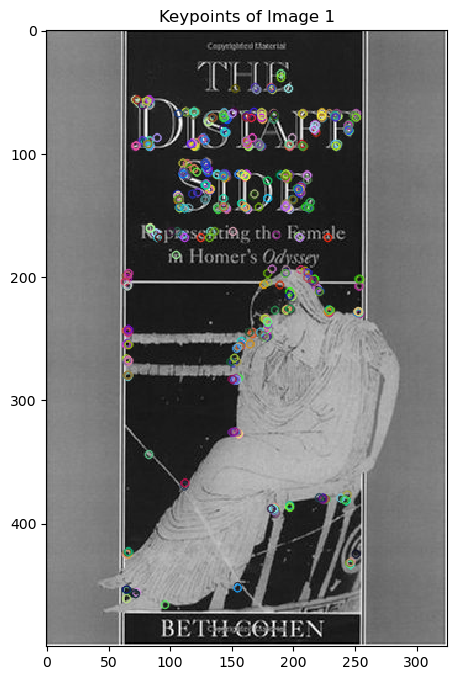

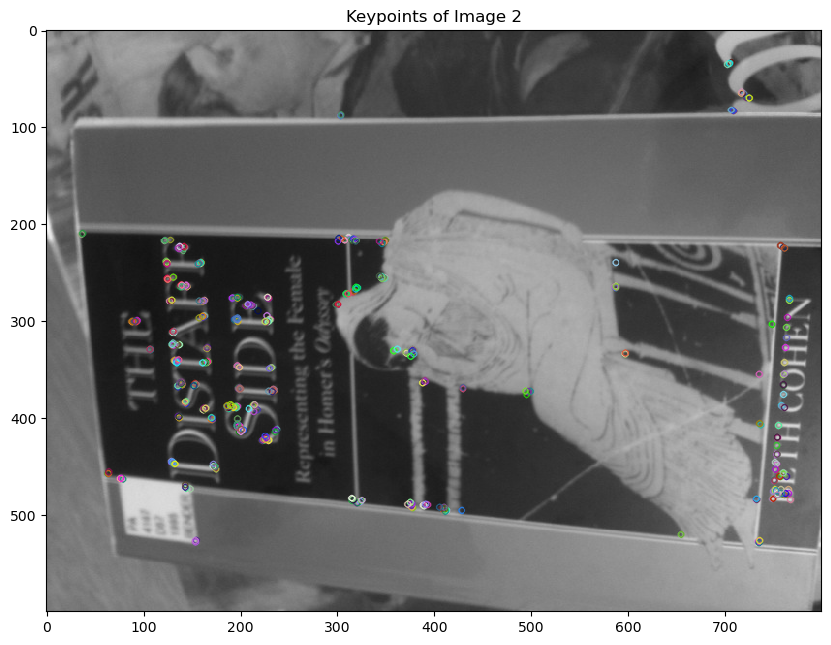

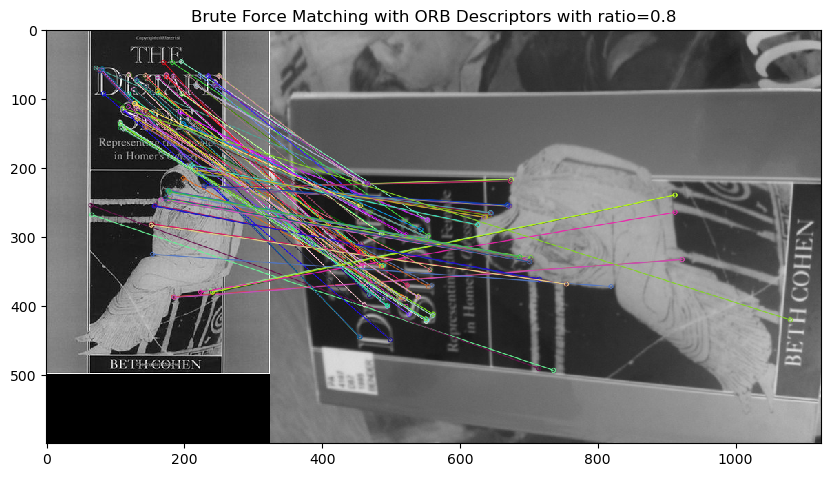

In [7]:
# Your code for descriptor matching tests here
# compute detector and descriptor, see (2) above
orb = cv2.ORB_create()

# find the keypoints and descriptors with ORB, see (2) above
kp1, des1 = orb.detectAndCompute(img1, None)
kp2, des2 = orb.detectAndCompute(img2, None)

# draw keypoints, see (2) above
# draw img1
plt.imshow(cv2.drawKeypoints(img1, kp1, 0))
plt.title("Keypoints of Image 1")
plt.show()
# draw img2
plt.imshow(cv2.drawKeypoints(img2, kp2, 0))
plt.title("Keypoints of Image 2")
plt.show()

# create BFMatcher object, see (3) above
bf = cv2.BFMatcher(cv2.NORM_HAMMING)

# Match descriptors, see (3) above
matches = bf.knnMatch(des1, des2, k = 2)

# Apply ratio test, see (3) above
ratio = 0.8
good = []
for m,n in matches:
    if m.distance < ratio * n.distance:
        good.append([m])
    
# draw matches, see (4) above
img3 = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good, None, flags = cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.title(f"Brute Force Matching with ORB Descriptors with {ratio=}") 
plt.imshow(img3)

### Changing Ratio Values for Ratio Test

In [8]:
def ORB_with_BFMatching(img1 = img1, img2 = img2, ratio = 0.8, distance = cv2.NORM_HAMMING, show = True, **kwargs) -> list:
    """
    Function to perform ORB with Brute Force Matching with visualizations
    -----------
    Inputs: 
        img1: reference image
        img2: query image
        ratio: ratio test threshold
        distance: distance function
        kwargs: parameters for ORB_create()
    Outputs:
        kp1: keypoints of img1
        kp2: keypoints of img2
        des1: descriptors of img1
        des2: descriptors of img2
        good: good matches after ratio test
        matches: all matches
    """
    # ratio is 0.8 default, distance is cv2.NORM_HAMMING default
    if not kwargs:
        orb = cv2.ORB_create()
    else:
        orb = cv2.ORB_create(**kwargs)
    # find the keypoints and descriptors with ORB, see (2) above
    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    # # draw keypoints, see (2) above
    # # draw img1
    # plt.imshow(cv2.drawKeypoints(img1, kp1, 0))
    # plt.title("Keypoints of Image 1")
    # plt.show()
    # # draw img2
    # plt.imshow(cv2.drawKeypoints(img2, kp2, 0))
    # plt.title("Keypoints of Image 2")
    # plt.show()
    # create BFMatcher object, see (3) above
    bf = cv2.BFMatcher(distance)
    # Match descriptors, see (3) above
    matches = bf.knnMatch(des1, des2, k = 2)

    # Apply ratio test, see (3) above
    good = []
    for m,n in matches:
        if m.distance < ratio * n.distance:
            good.append([m])
        
    # draw matches, see (4) above
    if show:
        img3 = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good, None, flags = cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        print(f"ORB_create() parameters: {kwargs}" if kwargs else "No parameters passed to ORB_create()")
        print('-' * 10)
        print(f"Number of total matches={len(matches)}")
        print(f"Number of matches within threshold={len(good)}")
        plt.title(f"Brute Force Matching with ORB Descriptors with {ratio=} and Distance Function {distance=}") 
        plt.imshow(img3)
        plt.show()
    return kp1, kp2, des1, des2, good, matches 

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=469


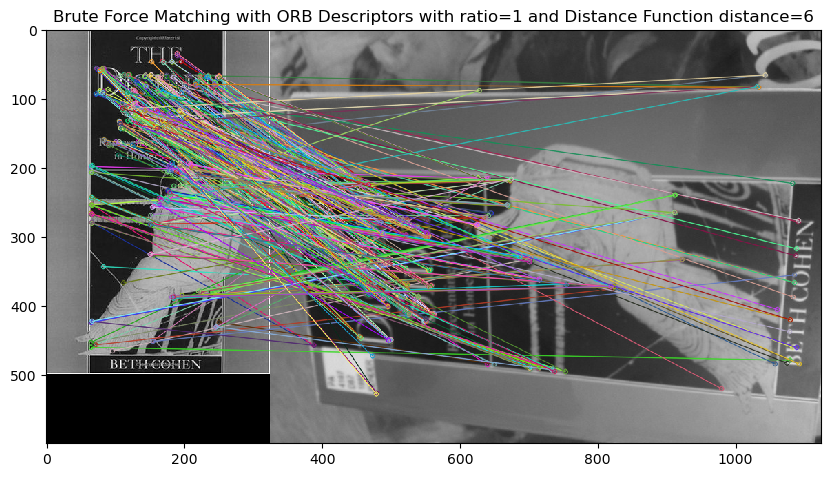

In [9]:
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 1)

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=242


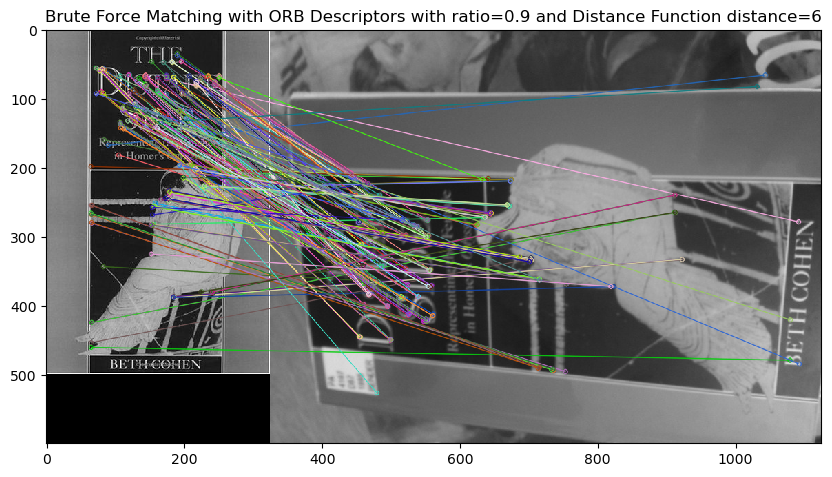

In [10]:
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.9)

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=19


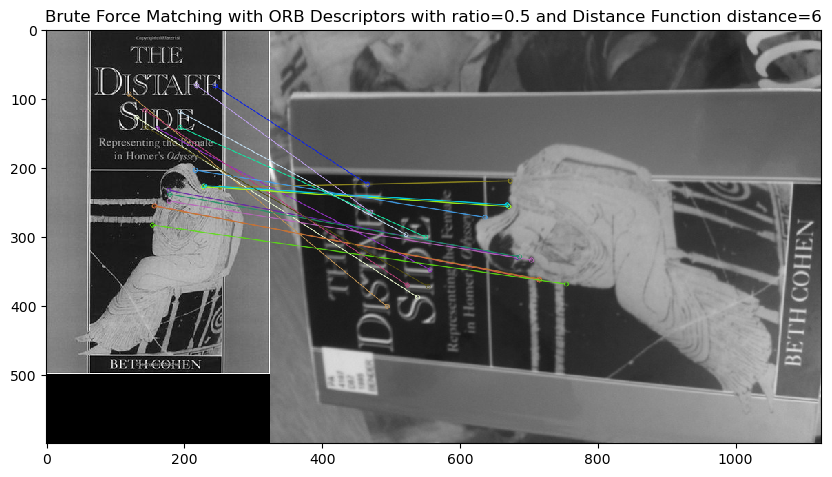

In [11]:
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.5)

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=1


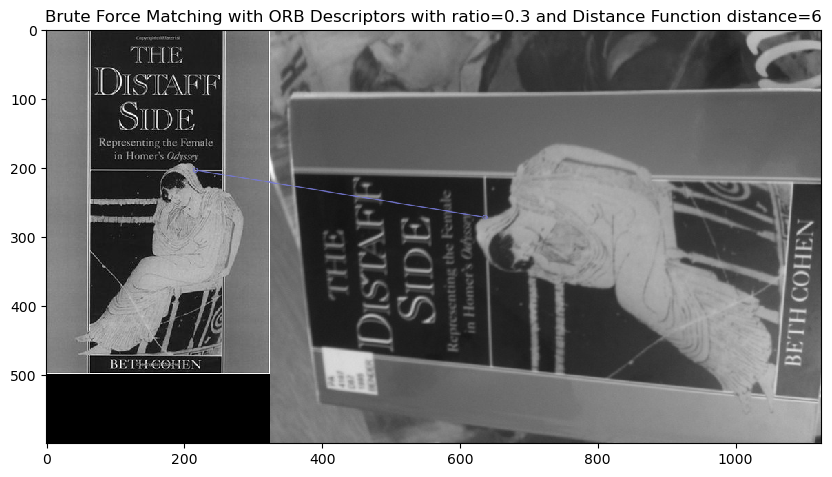

In [12]:
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.3)

***Explanation***

In the paper ["Distinctive Image Features from Scale-Invariant Keypoints"](https://link.springer.com/article/10.1023/B:VISI.0000029664.99615.94), Lowe explained that Keypoint matching can be effectively done by measuring the closest and second-closest neighbor's distance from the candidate point. Below is the graph of the PDFs of correct and incorrect matches of the keypoints with respect to ratio levels.

<img src= "SCR-20240705-npro.png" style="width: 30%; height: auto;">

In the experimentation above, we see that that at higher ratios (closer to 1) of the ratio-test, there would exist more matches between the query and reference as supported by the graph above, but this means that there are much more incorrect matches. As the ratios get closer to 0, we see that the number of matches decrease, but the number of incorrect matches decreased. This can be also seen in the graph above. We can see that a lower ratio value implies a "stricter" matching criteria to prevent false positive matches since we want to check which distances are close enough given a threshold multiplier.

### Changing ORB paremeters

#### Number of Features to retain (nfeatures)

ORB_create() parameters: {'nfeatures': 100}
----------
Number of total matches=100
Number of matches within threshold=23


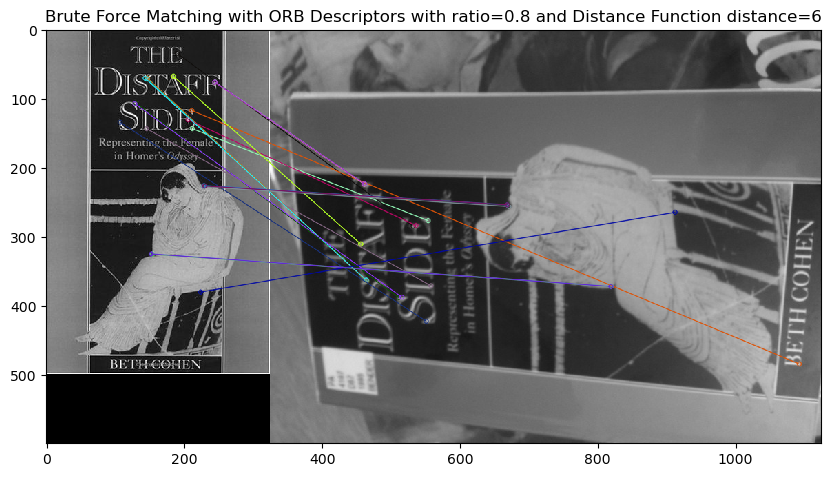


ORB_create() parameters: {'nfeatures': 250}
----------
Number of total matches=250
Number of matches within threshold=59


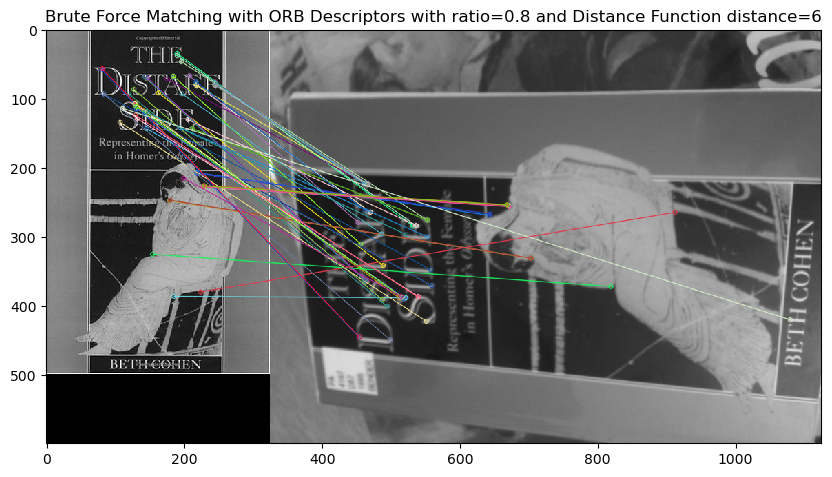


ORB_create() parameters: {'nfeatures': 500}
----------
Number of total matches=500
Number of matches within threshold=131


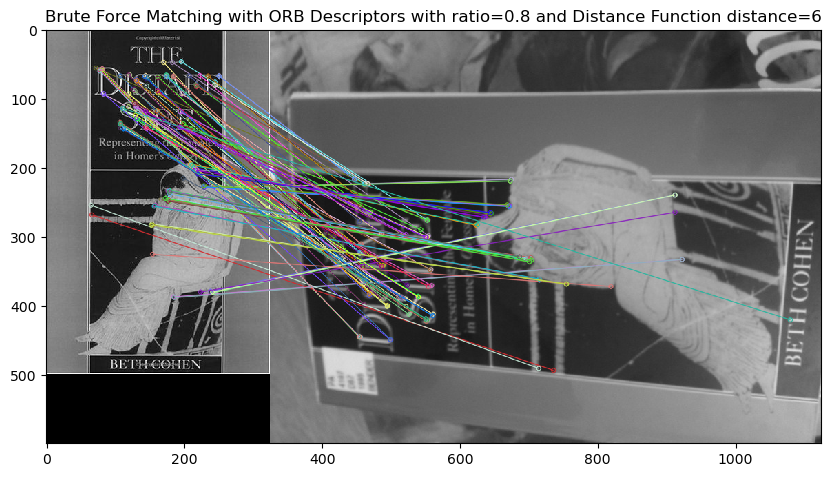


ORB_create() parameters: {'nfeatures': 1000}
----------
Number of total matches=981
Number of matches within threshold=221


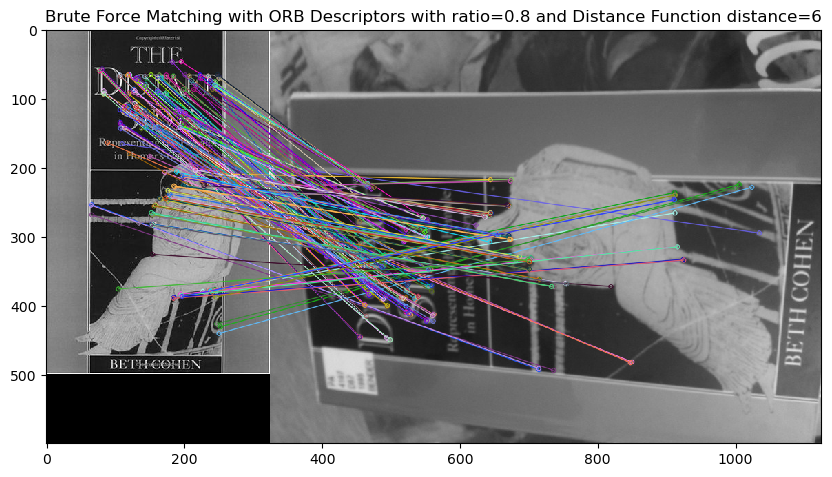


ORB_create() parameters: {'nfeatures': 5000}
----------
Number of total matches=3303
Number of matches within threshold=573


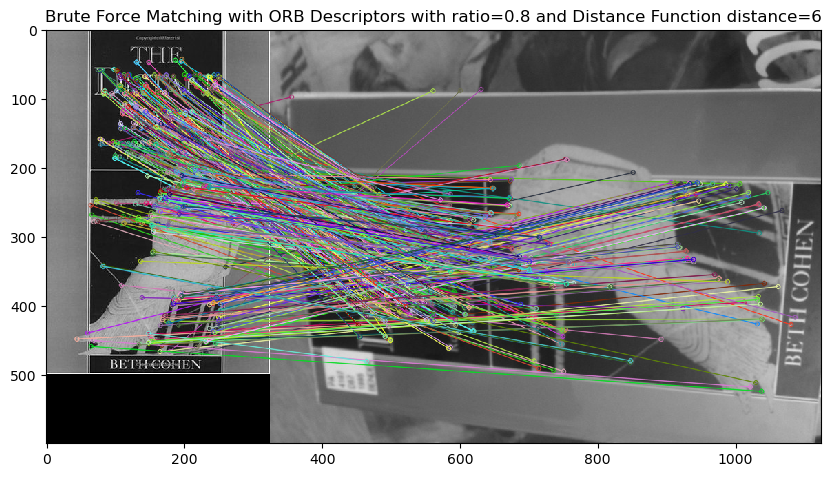

In [13]:
num_features = [100, 250, 500, 1000, 5000]

for n in num_features:
    kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.8, nfeatures = n)
    print()

***Explanation***

| Num of Features | Num of Matches Within Threshold |
|-----------------|-------------------------------|
| 100             | 23                            |
| 250             | 59                            |
| 500             | 131                           |
| 1000            | 221                           |
| 5000            | 573                           |


We see that the number of matches increase as the number of features increase. Additionally, we see that the increase is not necessarily linear, but increases complexity and time needed as number of features increases. By default, the library uses 500 number of features to balance both the quality matches (num of matches within threshold) and computational speed.

#### Pyramid Decimation Ratio

ORB_create() parameters: {'scaleFactor': 1}
----------
Number of total matches=500
Number of matches within threshold=38


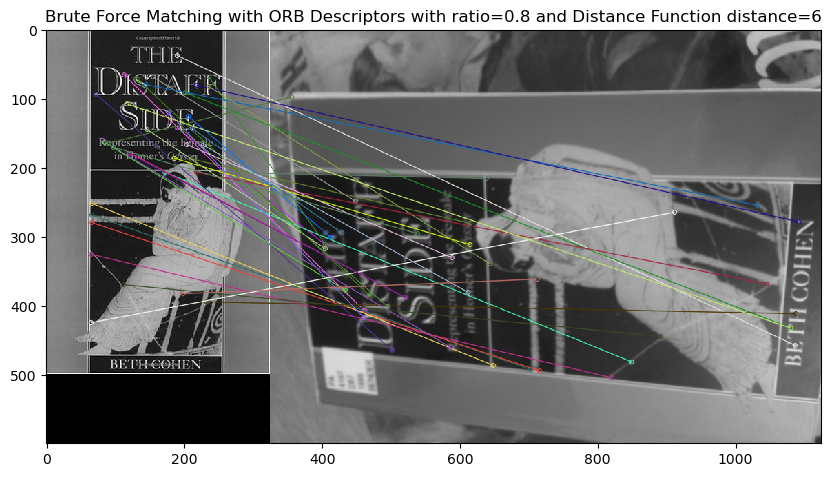


ORB_create() parameters: {'scaleFactor': 1.2}
----------
Number of total matches=500
Number of matches within threshold=131


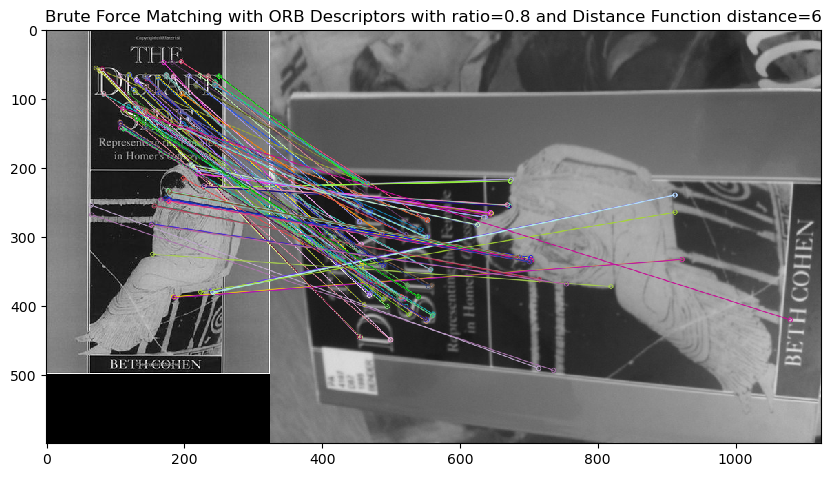


ORB_create() parameters: {'scaleFactor': 1.5}
----------
Number of total matches=417
Number of matches within threshold=102


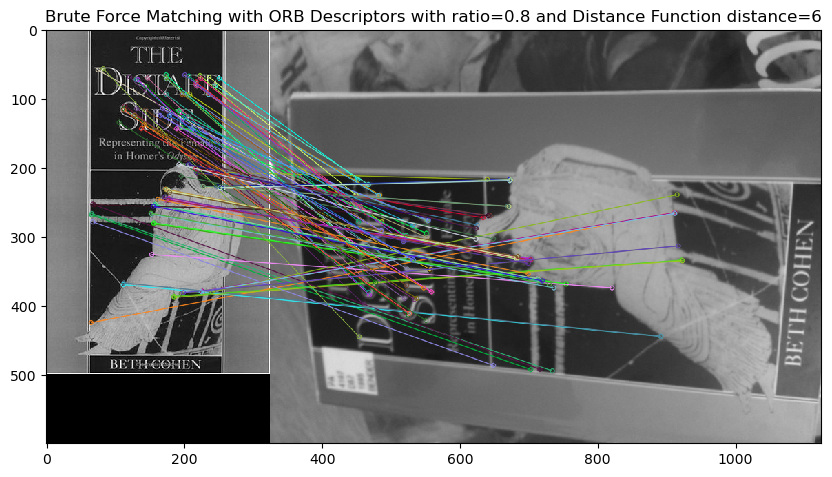


ORB_create() parameters: {'scaleFactor': 2}
----------
Number of total matches=416
Number of matches within threshold=41


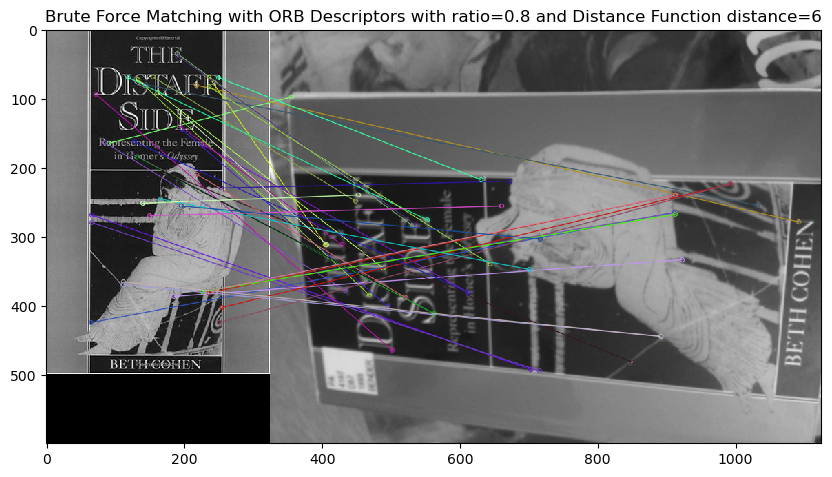


ORB_create() parameters: {'scaleFactor': 2.5}
----------
Number of total matches=420
Number of matches within threshold=38


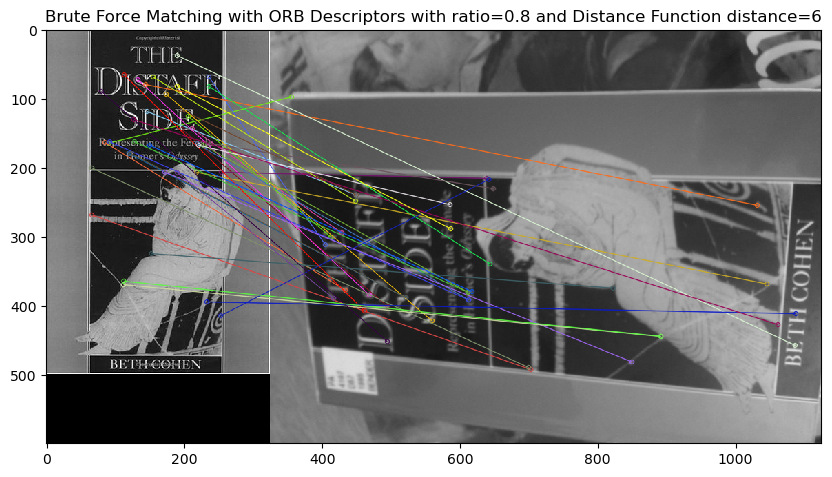

In [14]:
scale_factors = [1, 1.2, 1.5, 2, 2.5]

for sf in scale_factors:
    kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.8, scaleFactor = sf)
    print()

***Explanation***

| Scale Factor | Num of Matches Within Threshold |
|--------------|---------------------------------|
| 1            | 38                              |
| 1.2          | 131                             |
| 1.5          | 102                             |
| 2            | 41                              |
| 2.5          | 38                              |


In the documentation, scale factor pertains to the blurring strength to be conducted on the Gaussian Pyramid. A factor of 2 is the classical Gaussain Pyramid where each level has 4x less pixels than the previous. We see that the the value 1.2, which is also the default Scale Factor, performs the best with the highest number of matches within the threshold.

#### Edge Threshold and Patch Size

ORB_create() parameters: {'edgeThreshold': 10, 'patchSize': 10}
----------
Number of total matches=500
Number of matches within threshold=102


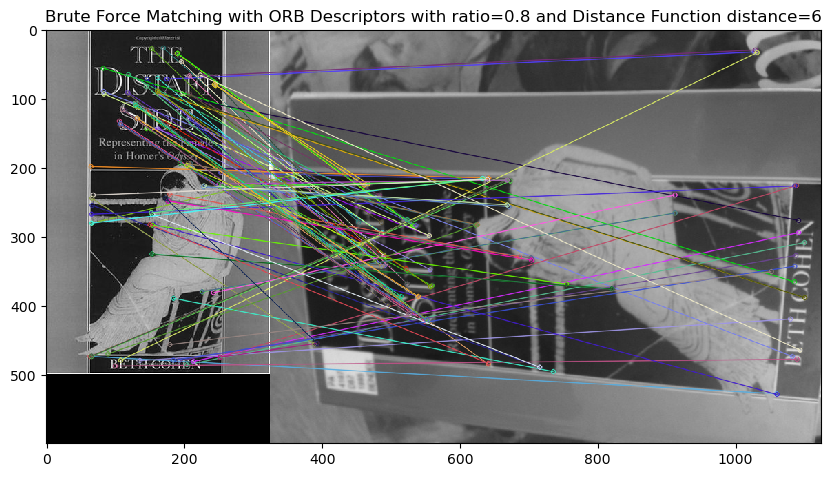


ORB_create() parameters: {'edgeThreshold': 21, 'patchSize': 21}
----------
Number of total matches=500
Number of matches within threshold=110


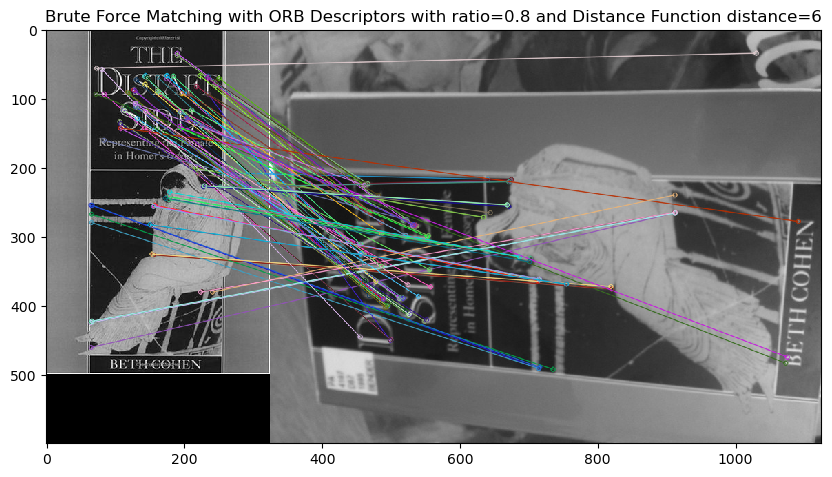


ORB_create() parameters: {'edgeThreshold': 31, 'patchSize': 31}
----------
Number of total matches=500
Number of matches within threshold=131


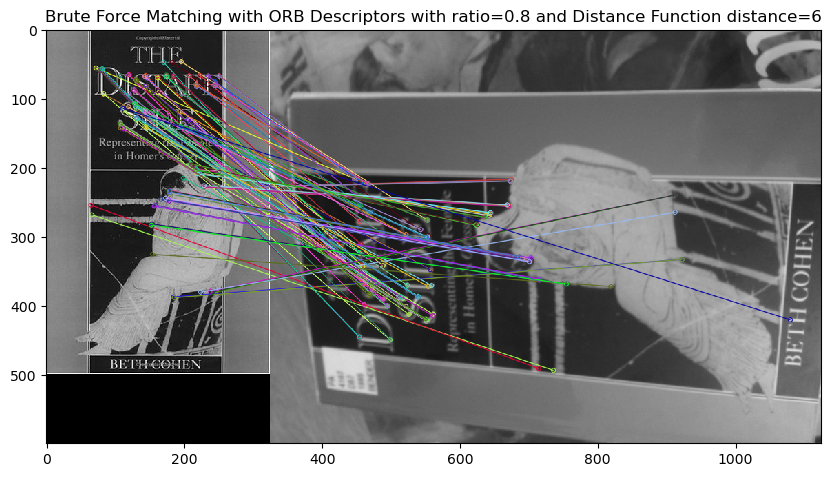


ORB_create() parameters: {'edgeThreshold': 41, 'patchSize': 41}
----------
Number of total matches=476
Number of matches within threshold=129


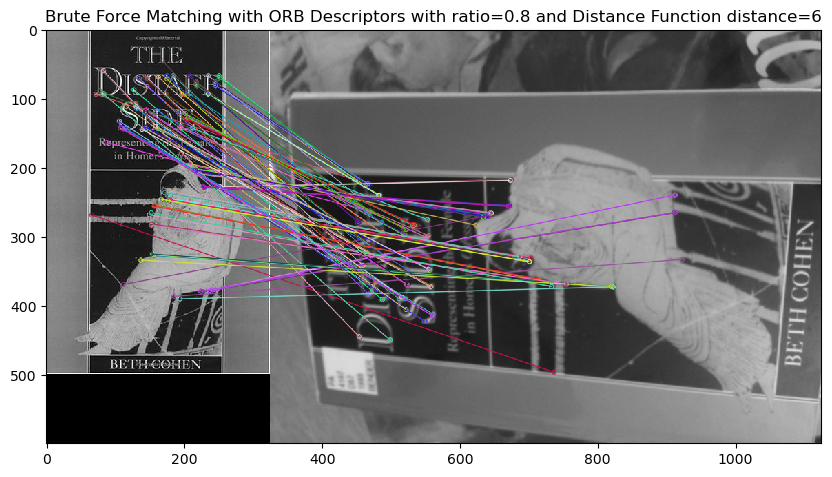


ORB_create() parameters: {'edgeThreshold': 51, 'patchSize': 51}
----------
Number of total matches=442
Number of matches within threshold=117


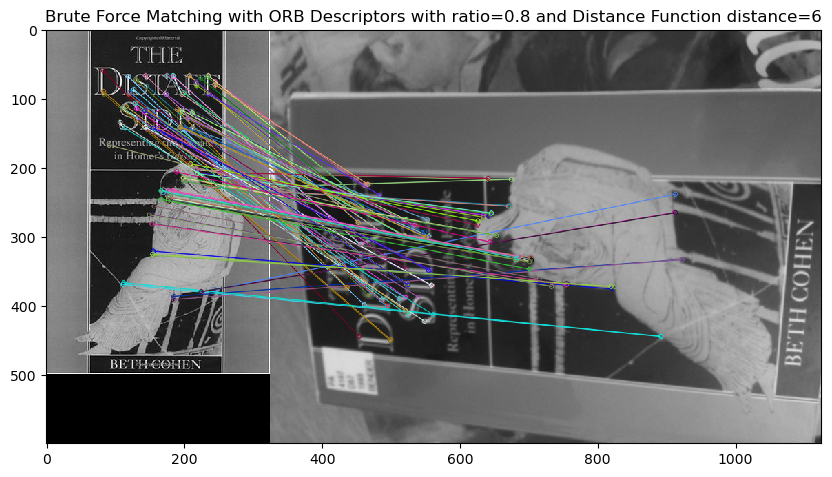

In [15]:
r_values = [10, 21, 31, 41, 51]

for r in r_values:
    kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.8, edgeThreshold = r, patchSize = r)
    print()

***Explanation***

| Patch Size | Num of Matches Within Threshold |
|------------|---------------------------------|
| 10         | 102                             |
| 21         | 110                             |
| 31         | 131                             |
| 41         | 129                             |
| 51         | 117                             |


The paper explains how the Edge thresholds and Patch Size pertains to some distance $r$ where it pertains to the total size of an image patch which is a subsection of an image centered at pixel $n$ with radius $r$. Experimentally, the researchers of the ORB paper determined that the best value patch size is $31$ x $31$. Similarly, in the experiments, it can be observed how the afforementioned patch yielded to the best results, but given that the number of matches are relatively close, we can consider some values as potential candidates. By default, the CV2 package uses the value of 31 as default as discussed by the paper extensively.

#### Score Type (Harris Score vs FAST SCORE)

ORB_create() parameters: {'scoreType': 0}
----------
Number of total matches=500
Number of matches within threshold=131


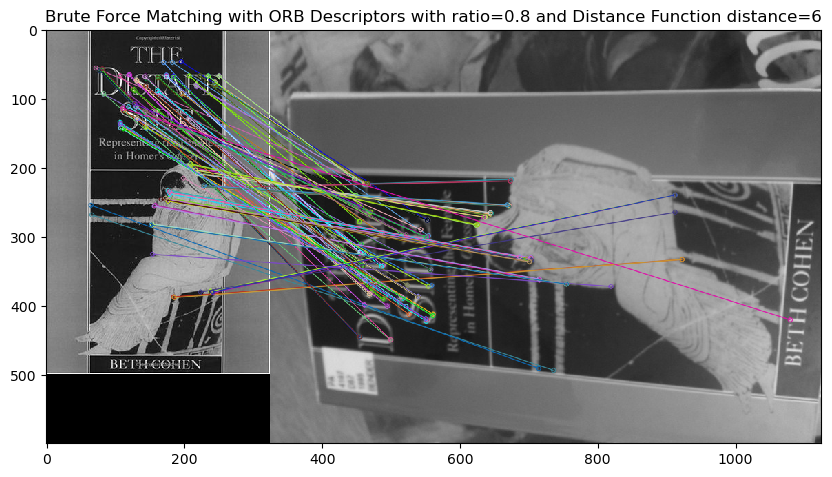

In [16]:
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.8, scoreType = cv2.ORB_HARRIS_SCORE)

ORB_create() parameters: {'scoreType': 1}
----------
Number of total matches=510
Number of matches within threshold=116


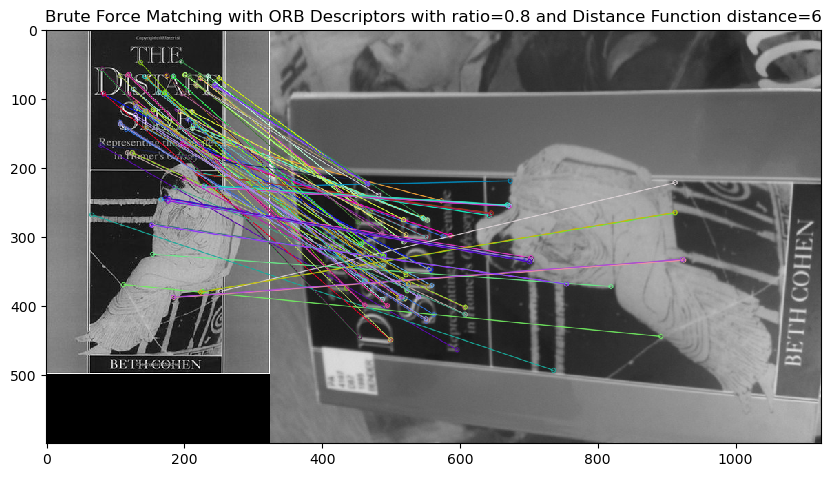

In [17]:
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1, img2, 0.8, scoreType = cv2.ORB_FAST_SCORE)

***Explanation***

| Score Type | Num of Matches Within Threshold |
|--------------|---------------------------------|
| Harris        | 131                              |
| FAST         | 116                             |



Manipulating the ranking algorithm to evaluate features, we see that the Harris algorithm outperformed the FAST Score, but that is to be expected as FAST computes the keypoints faster at the cost of less stable keypoints.

### Changing Distance Function

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=131


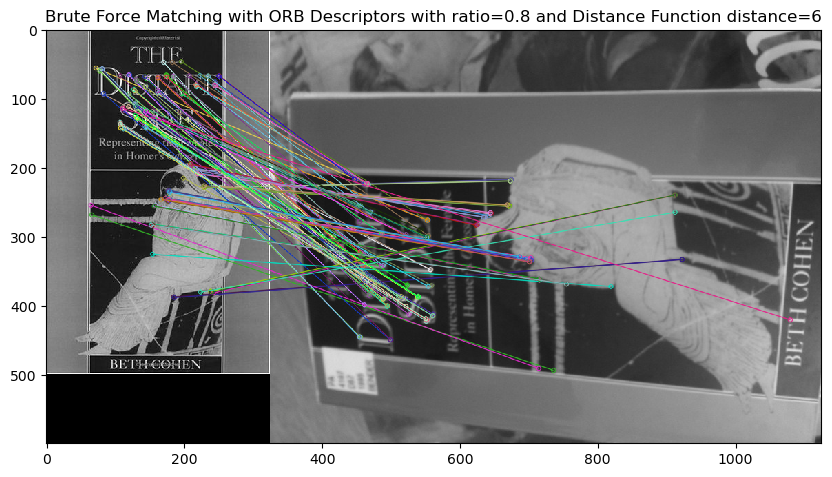

In [18]:
# Hamming Distance
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1=img1, img2=img2, distance=cv2.NORM_HAMMING)

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=109


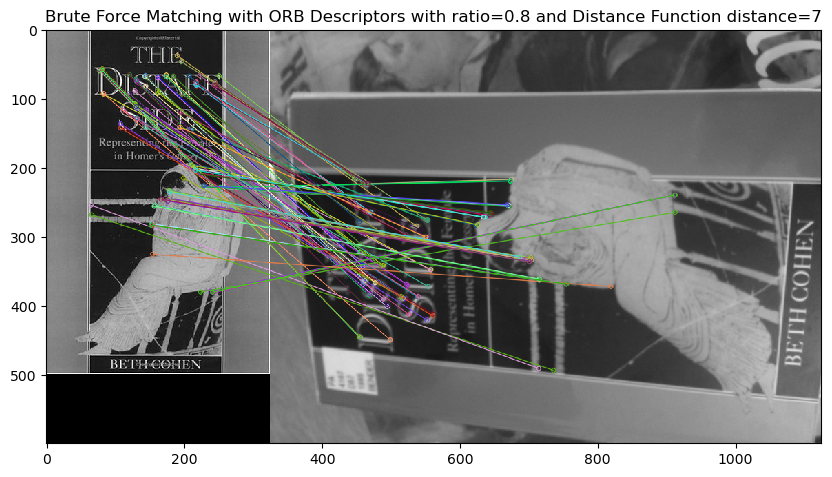

In [19]:
# Hamming2 Distance
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1=img1, img2=img2, distance=cv2.NORM_HAMMING2)

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=51


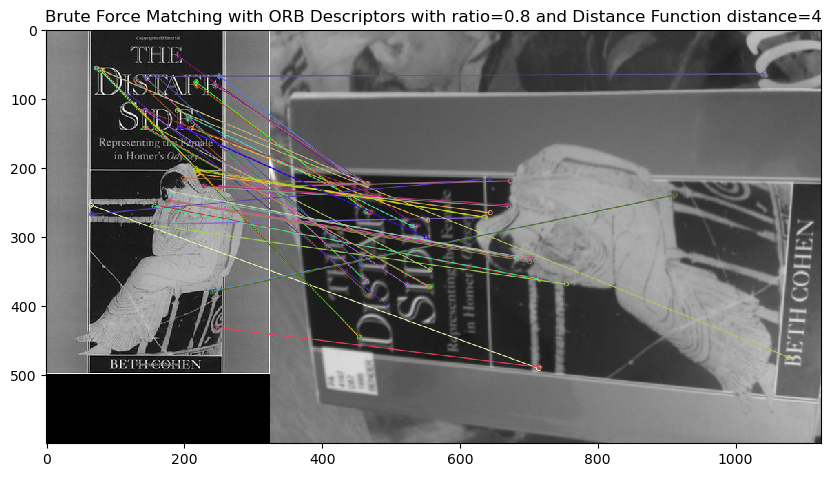

In [20]:
# L2 Distance
kp1, kp2, des1, des2, good, matches = ORB_with_BFMatching(img1=img1, img2=img2, distance=cv2.NORM_L2)

***Explanation***

It can be observed that the ORB descriptors are binary. This means that other distance functions such as L1 and L2 norm might not be particularly appropriate given their definitions. It is common convention to use Hamming or Hamming2 (which accounts for rotation invariance) and both account for difference in bit positions given binary strings. While not necessarily different distance functions (strictly speaking), Hamming2 is more appropriate when considering features that are rotationally invariant. In the example above, we can see that number of matches  within the threshold decreased from Hamming to Hamming2 and the number of good matches. Moreover, we see that the L2 norm performed the worst compared to the using Hamming Distances.

## Homography

5. Estimate a homography transformation based on the matches, using `cv2.findHomography()`. Display the transformed outline of the first reference book cover image on the query image, to see how well they match.

    - We provide a function `draw_outline()` to help with the display, but you may need to edit it for your needs.
    - Try the 'least squre method' option to compute homography, and visualize the inliers by using `cv2.drawMatches()`. Explain your results.
    - Again, you don't need to compare results numerically at this stage. Comment on what you observe visually.

### Least Squares Method

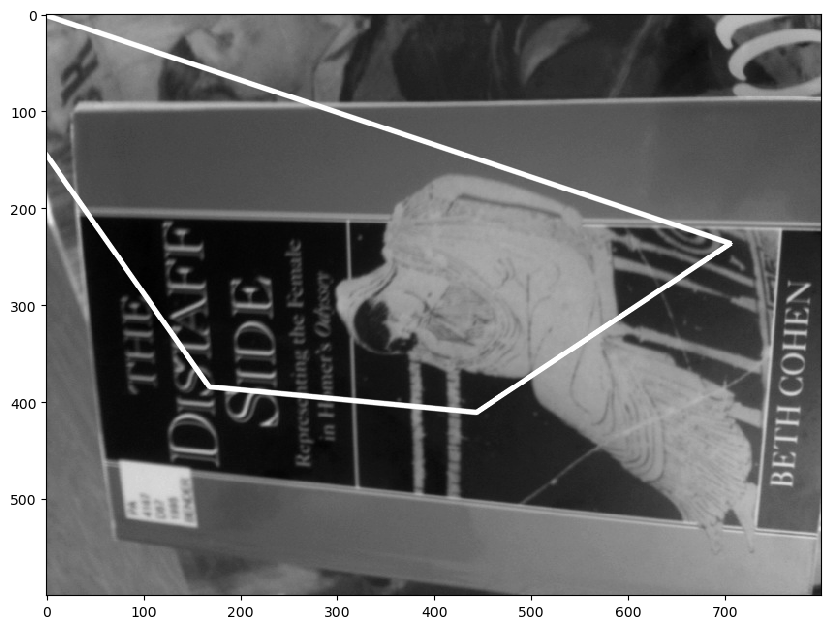

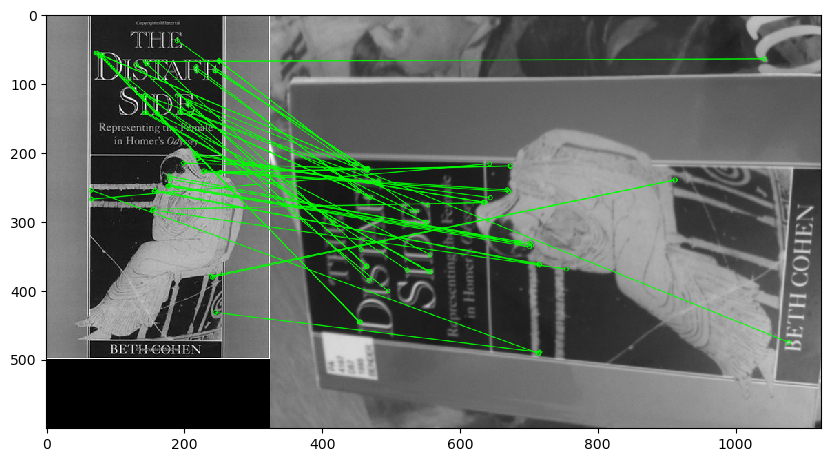

In [21]:
# Code adapted from: https://docs.opencv.org/3.4/d1/de0/tutorial_py_feature_homography.html

# Define a minimum number of of matches needed
min_match_count = 10
if len(good) >= min_match_count:
    # Create src_pts and dst_pts as float arrays to be passed into cv2.,findHomography
    src_pts = np.float32([kp1[m[0].queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m[0].trainIdx].pt for m in good]).reshape(-1,1,2)

    # using cv2 standard method, see (3) above
    # value of 0 uses the least squares bethod. 
    M, mask = cv2.findHomography(src_pts, dst_pts, method=0)
    # draw frame
    draw_outline(img1, img2, M)
    # draw inliers
    draw_inliers(img1,img2, kp1, kp2, [m[0] for m in good], mask)
else:
    print("Not enough matches are found; Matches: {}, Minimum Needed: {}".format(len(good), min_match_count))


***Explanation***

It can be observed that the outline produced from the least squares method poorly depicts the outline of the book cover. When examining the inliers, it is apparent that some matches are not necessarily correct. We see in the Author's Name 'BETH' where the vertical stroke of 'H' is matched to similar looking italics of 'I' or 'D'. This incorrect correspondence heavily impacts the estimation as it fails to appropriately catch the transformation and can be labelled as noise. Due to outliers like these, it can negatively impact the homography estimation. 

### RANSAC Method

Try the RANSAC option to compute homography. Change the RANSAC parameters, and explain your results. Print and analyze the inlier numbers.

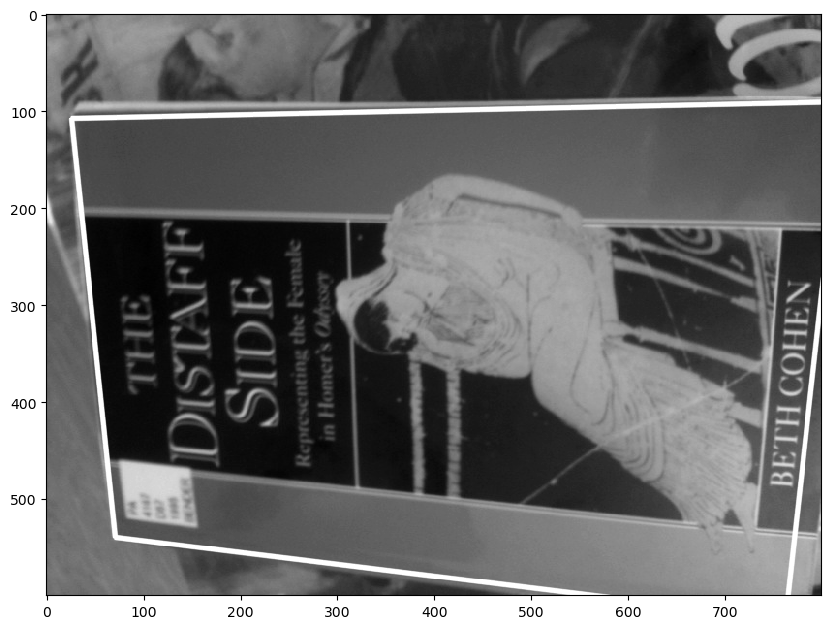

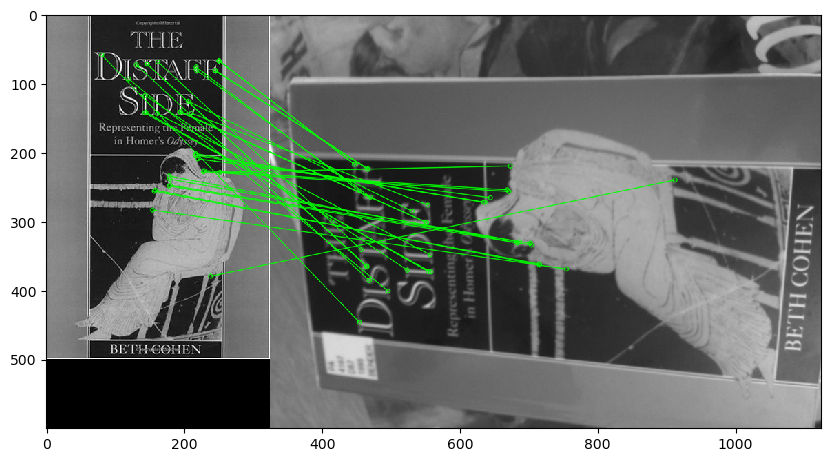

Inlier Count: 34


In [22]:
# Using RANSAC
M_ransac, mask_ransac = cv2.findHomography(src_pts, dst_pts, method=cv2.RANSAC, ransacReprojThreshold=5)
# draw frame
draw_outline(img1, img2, M_ransac)
# draw inliers
draw_inliers(img1,img2, kp1, kp2, [m[0] for m in good], mask_ransac)

# inlier number
print(f"Inlier Count: {sum(mask_ransac.ravel().tolist())}")

The main pararmeter in consideration would be the ransacReprojThreshold is given by the formula:

$\left\| \text{dstPoints}_i - \text{convertPointsHomogeneous}(\mathbf{H} \cdot \text{srcPoints}_i) \right\|_2 > \text{ransacReprojThreshold}$

The other parameters of RANSAC rely on statistical assumptions usch as confidence levels or number of iterations. It may be worthwhile to assess how the change in threshold impact the inliers since this dictates what is "far enough" from the converted srcPoints from the dstPoints using its L2 norm. We will show each iteration testing a different threshold and then graph the number of inliers. The documentation suggests that the parameter is a float in range of 1 to 10.

In [23]:
def RANSAC_homography(ref_img, q_img, ref_kp, q_kp, good, ransacReprojThreshold=5, min_match_count = 5, show = False):
    try:
        # ensure that there are enough matches
        assert len(good) >= min_match_count
        # Create src_pts and dst_pts as float arrays to be passed into cv2.,findHomography
        src_pts = np.float32([ref_kp[m[0].queryIdx].pt for m in good]).reshape(-1,1,2)
        dst_pts = np.float32([q_kp[m[0].trainIdx].pt for m in good]).reshape(-1,1,2)

        M_ransac, mask_ransac = cv2.findHomography(src_pts, dst_pts, method=cv2.RANSAC,ransacReprojThreshold=ransacReprojThreshold)
        # draw frame
        if show:
            draw_outline(ref_img,q_img, M_ransac)
            # draw inliers
            draw_inliers(ref_img,q_img, ref_kp, q_kp, [m[0] for m in good], mask_ransac)

            # inlier number
            print(f"Inlier Count: {sum(mask_ransac.ravel().tolist())}")
        return (M_ransac, mask_ransac, sum(mask_ransac.ravel().tolist()))
    except:
        # print("Not enough matches are found; Matches: {}, Minimum Needed: {}".format(len(good), min_match_count))
        return None, None, 0
   

In [24]:
thresholds = [1,1.3,1.5,1.9,2,2.5,3,4,5,6,7,8,9,10]
inliers = []
for t in thresholds:
    Model, mask, inl = RANSAC_homography(img1, img2, kp1, kp2, good, t, 5)
    print(f"Threshold: {t}, Inliers: {inl}")
    inliers.append(inl)

Threshold: 1, Inliers: 14
Threshold: 1.3, Inliers: 16
Threshold: 1.5, Inliers: 16
Threshold: 1.9, Inliers: 20
Threshold: 2, Inliers: 21
Threshold: 2.5, Inliers: 24
Threshold: 3, Inliers: 28
Threshold: 4, Inliers: 33
Threshold: 5, Inliers: 34
Threshold: 6, Inliers: 37
Threshold: 7, Inliers: 38
Threshold: 8, Inliers: 38
Threshold: 9, Inliers: 38
Threshold: 10, Inliers: 39


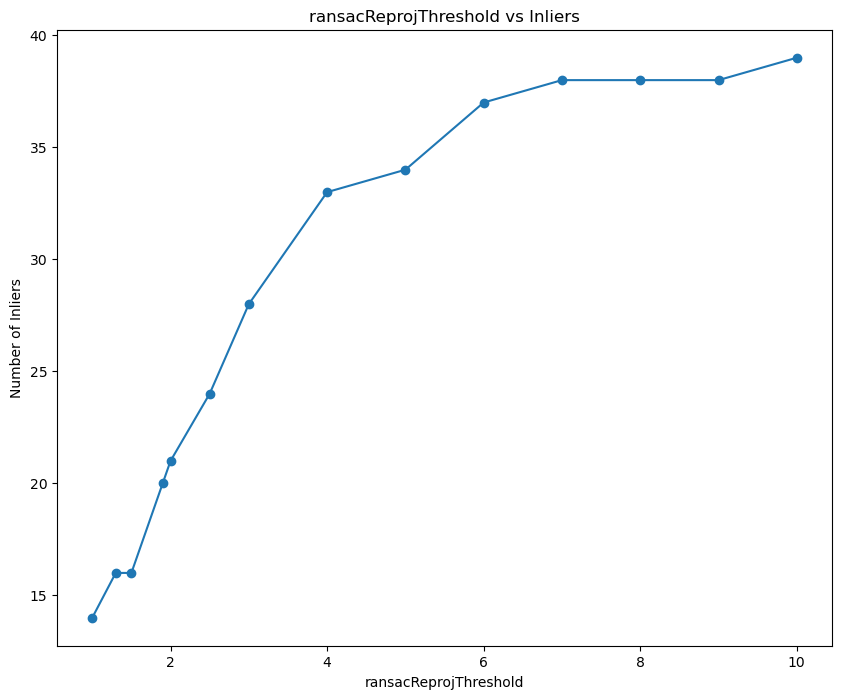

In [25]:
plt.plot(thresholds, inliers, marker='o')
plt.title("ransacReprojThreshold vs Inliers")
plt.xlabel("ransacReprojThreshold")
plt.ylabel("Number of Inliers")
plt.show()

It can be observed that at the threshold 1, there are 33 inliers, while at threshold 10, there are 114 inliers. It can also be seen that generally, as the threshold increases, there would be more inliers as supported by the formula definition. A larger threhold means that there are more "far enough" pairs of keypoints, but this also means that the distance between the keypoints increase as the threshold increases. This might introduce more noise as threshold increases. A somewhat weak logarithmic trend can also be discovered as the change of inlier count from threshold 1 to 5 is drastically much larger than the inlier count from threshold 5 to 10. This shows that the inlier count will increase up until an extend and will reach a plateau. We observe that threshold 5 is close to threshold 10 and any value in this range can assume a good value we can choose from.

## Match several image pairs from the data provided

6. Finally, try matching several different image pairs from the data provided, including at least one success and one failure case. For the failure case, test and explain what step in the feature matching has failed, and try to improve it. Display and discuss your findings.
    1. Hint 1: In general, the book covers should be the easiest to match, while the landmarks are the hardest.
    2. Hint 2: Explain why you chose each example shown, and what parameter settings were used.
    3. Hint 3: Possible failure points include the feature detector, the feature descriptor, the matching strategy, or a combination of these.

### Successful Case 1: Book

In [26]:
book_img1 = cv2.imread(PATH + '/A2_smvs/book_covers/Reference/007.jpg', 0)
book_img2 = cv2.imread(PATH + '/A2_smvs/book_covers/Query/007.jpg', 0)

No parameters passed to ORB_create()
----------
Number of total matches=490
Number of matches within threshold=66


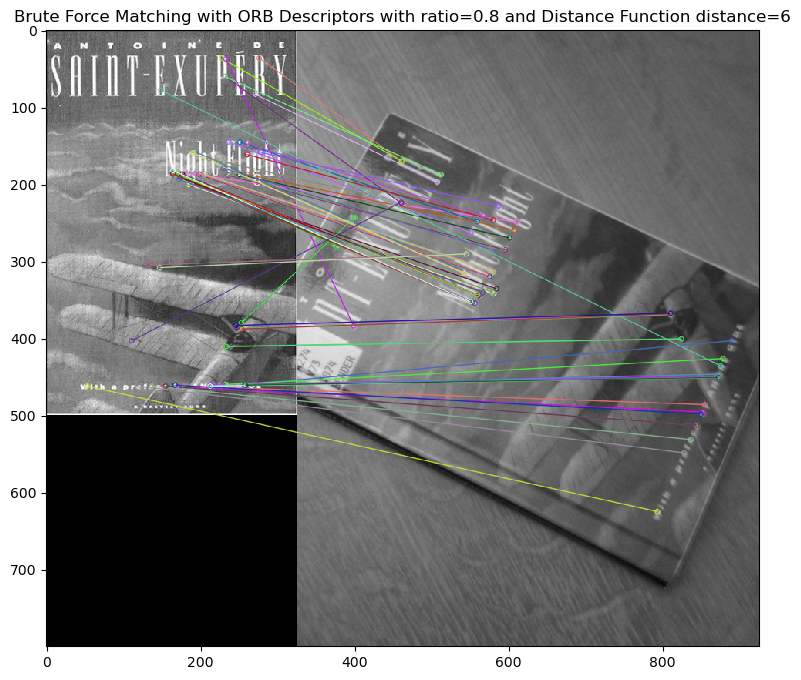

In [27]:
# ORB and feature matching with default values of ORB_create() given its good performance
book_kp1, book_kp2, book_des1, book_des2, book_good, book_matches = ORB_with_BFMatching(book_img1, book_img2)

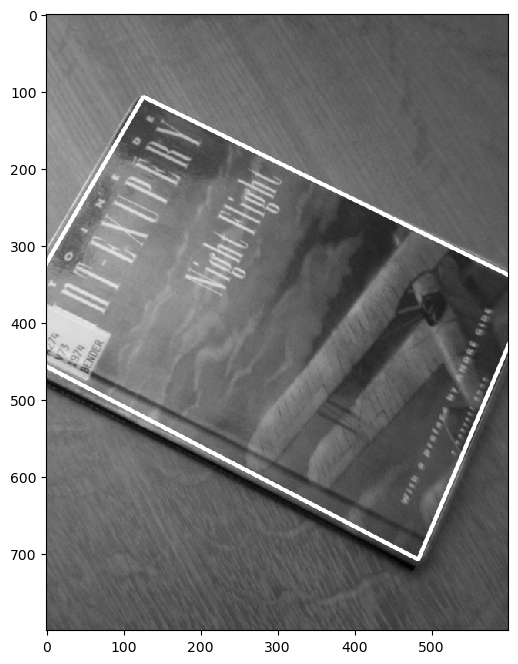

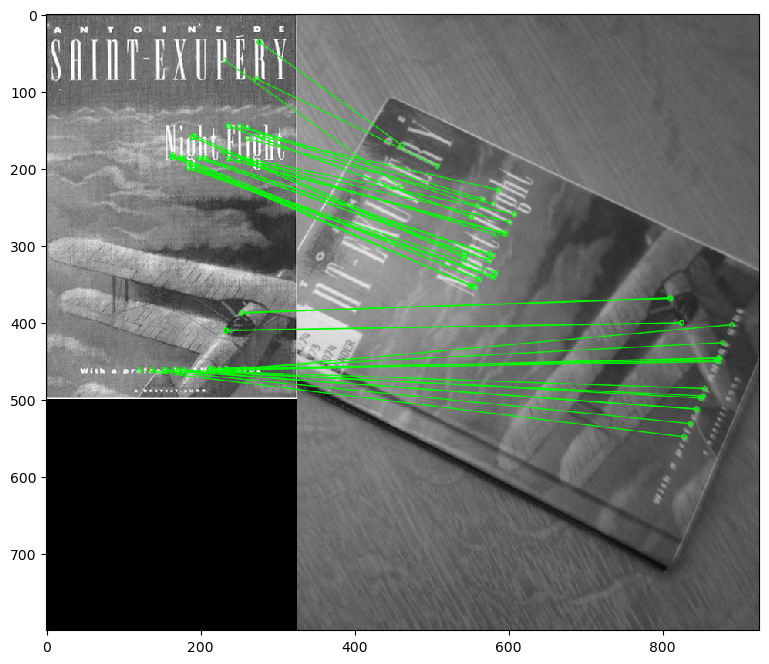

Inlier Count: 46


In [28]:
Model, mask, inlers = RANSAC_homography(book_img1, book_img2, book_kp1, book_kp2, book_good, show=True)

***Explanation***

Reason for image: book_cover 7's reference contains an image with clear text that is of font color white starkly contrasting its background. I also wanted to inspect performance of keypoint detection of clouds, where it can be seen that it blends and is not too discrete in terms of color values. 

Parameters Chosen:

- Ratio Threshold: 0.8
- Distance Function: Hamming Distance
- Number of Features: 500
- Scale Factor: 1.2
- Patch Size and Edge Threshold: 31
- Score Type: Harris Score
- Reprojection Threshold: 5
- As explained, we saw that the default values of ORB and RANSAC performed reasonably well, which is the reason why we used the same parameters to predict another set of book.

Results:

- Total Matches: 490
- Matches within Threshold (Good): 66
- Number of Inliers: 46
- It can be observed that the the outline produce by the estimation captured the book cover almost perfectly.

### Successful Case 2: Painting

In [29]:
paint_img1 = cv2.imread(PATH + '/A2_smvs/museum_paintings/Reference/008.jpg', 0)
paint_img2 = cv2.imread(PATH + '/A2_smvs/museum_paintings/Query/008.jpg', 0)

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=146


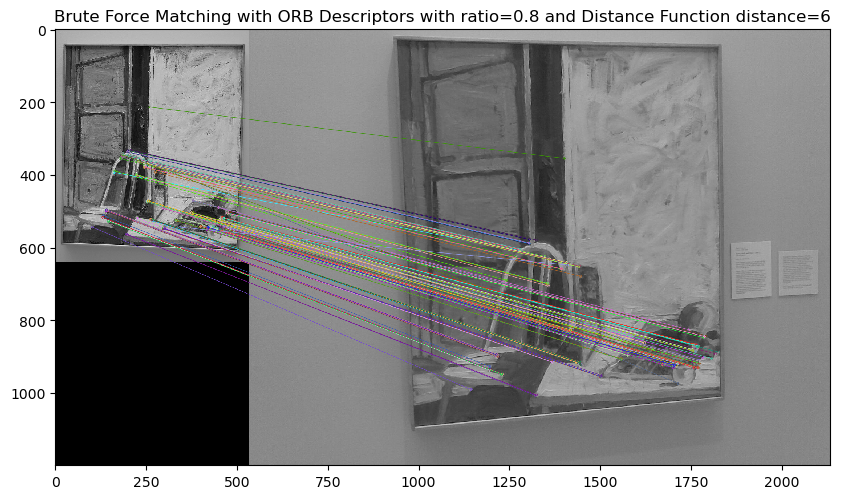

In [30]:
# ORB and feature matching with default values of ORB_create() given its good performance
paint_kp1, paint_kp2, paint_des1, paint_des2, paint_good, paint_matches = ORB_with_BFMatching(paint_img1, paint_img2)

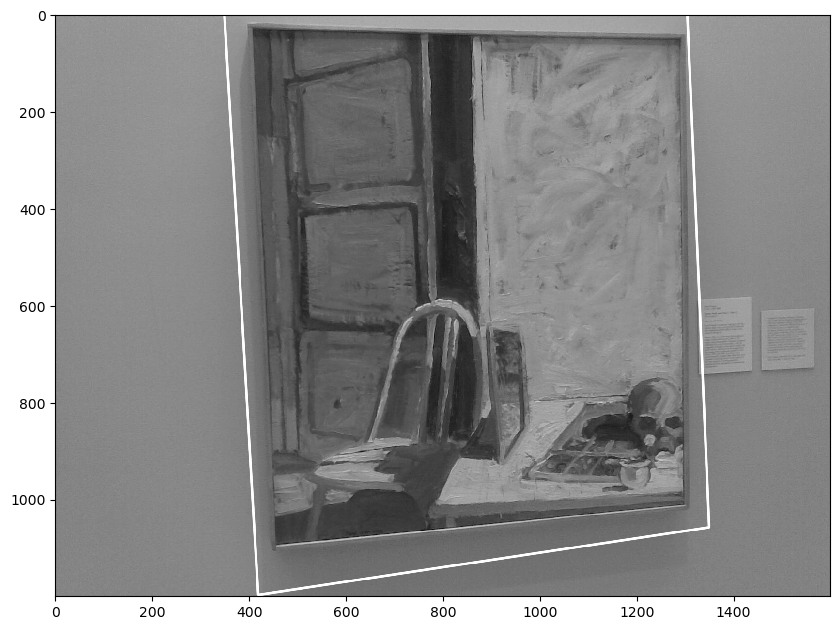

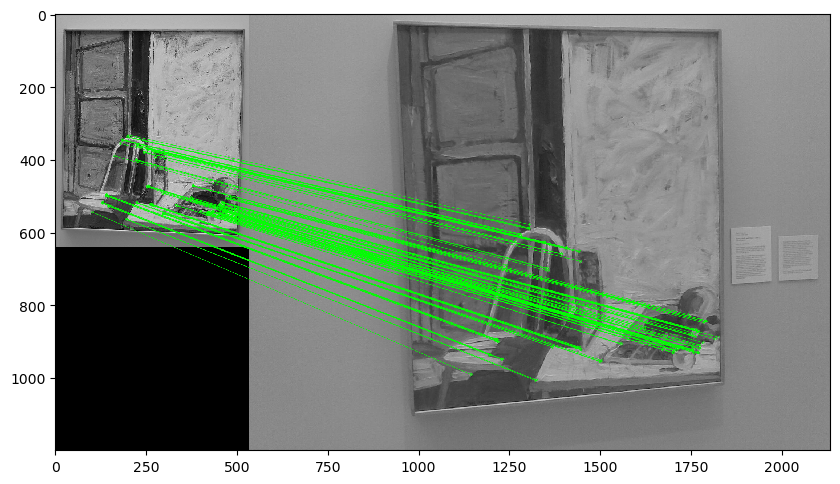

Inlier Count: 127


In [31]:
Model, mask, inlers = RANSAC_homography(paint_img1, paint_img2, paint_kp1, paint_kp2, paint_good,show=True)

***Explanation***

Reason for image: I chose museum_paintings 8 given I recognize Pablo Picasso's artstyle where the edge of the picture (or outlines) are most implied with changes in the values of the edges of the objects in the painting. Given this, I wanted to evaluate the performance on this painting as well. However, One consideration I wanted to try was seeing the effect of the Reference image not being "perfectly" mapped since we see the picture of the painting. Compared to the book, we see the book itself encompasses the entire image where the edges of the book correspond to  the edges of the image, unlike the reference picture here.

Parameters Chosen:

- Ratio Threshold: 0.8
- Distance Function: Hamming Distance
- Number of Features: 500
- Scale Factor: 1.2
- Patch Size and Edge Threshold: 31
- Score Type: Harris Score
- Reprojection Threshold: 5

Results:

- Total Matches: 500 
- Matches within Threshold (Good): 146
- Number of Inliers: 127
- It can be observed that the the outline produce by the estimation was somewhat off but still encapsulate the painting in its entirety, if we evaluate the pairings, we see that the keypoints' correspondence was reasonably correct. We can see that the estimator's orientation is similar to the outline of the painting itself, but it does not perfectly fit 1:1 with the different outlines. This lack of perfection can be explained with the reference image since it does not perfectly capture the edge of the painting itself dissimilar to the book where the edges of the book is literally the corners of the picture. In the painting example, we can see how the edges of the painting is within the picture, which implies an imperfect match unless we manually crop this out.

### Unsuccessful Case 3: Landmark

In [32]:
L1_img1 = cv2.imread(PATH + '/A2_smvs/landmarks/Reference/028.jpg', 0)
L1_img2 = cv2.imread(PATH + '/A2_smvs/landmarks/Query/028.jpg', 0)

No parameters passed to ORB_create()
----------
Number of total matches=500
Number of matches within threshold=30


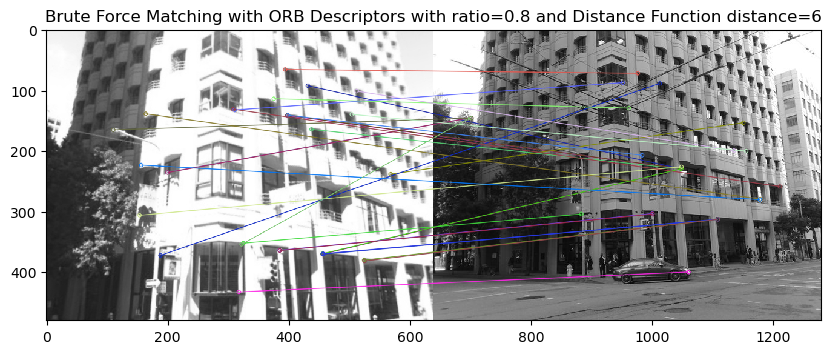

In [33]:
# ORB and feature matching with default values of ORB_create() given its good performance
L1_kp1, L1_kp2, L1_des1, L1_des2, L1_good, L1_matches = ORB_with_BFMatching(L1_img1, L1_img2)


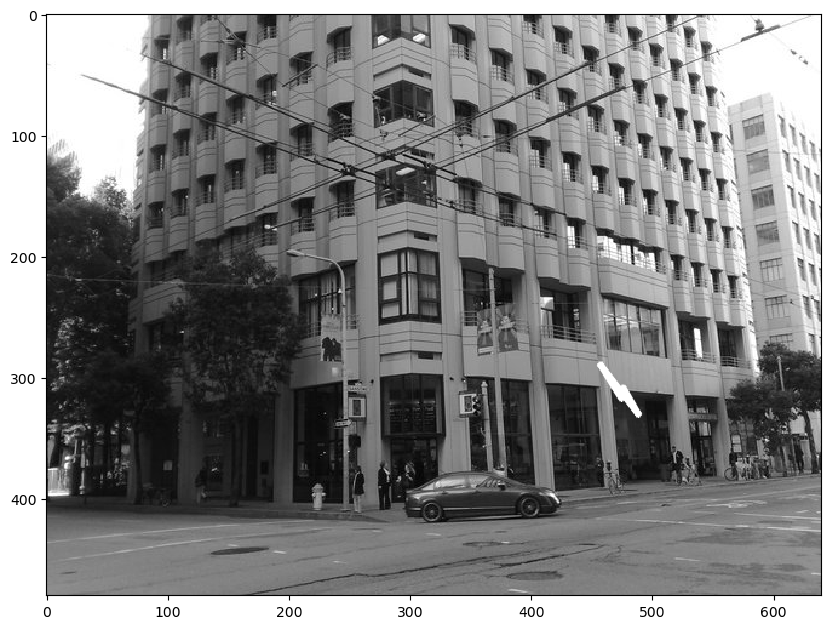

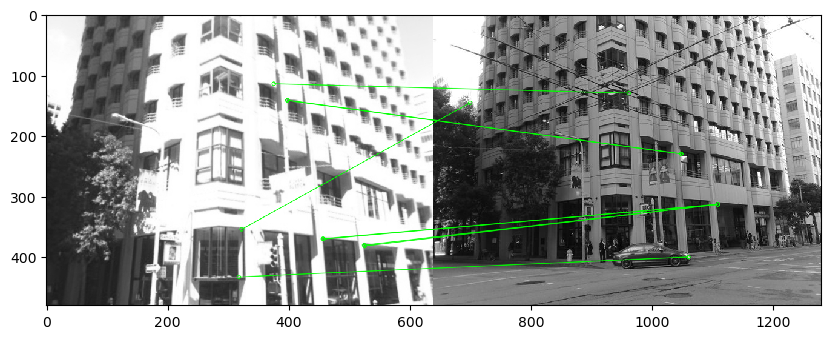

Inlier Count: 9


In [34]:
Model, mask, inlers = RANSAC_homography(L1_img1, L1_img2, L1_kp1, L1_kp2, L1_good,show=True)

***Explanation***

Results:


- Total Matches: 500 
- Matches within Threshold (Good): 30
- Number of Inliers: 9
- Compared to the previous two image pairs, we see that feature matching and homography estimate performed the poorest. We see that there are only 30 good matches and 9 inliers. Moreover, we see that some keypoints have incorrect correspondence which might explain the poor homography estimation. 

#### Attempt of improvement - Changing parameters

Recall increasing the number of features and reprojection thresholds would increase the number of inliers. This attempt proposes to increases the parameters to the following:


- RANSACReprojThreshold = 7
- Number of Max Features = 1000

We can also experiment with slightly increasing the path size and edge threshold to 41 for our keypoint generation given similar results in our experimentation.

- Patch Size = 41
- Edge Threshold = 41

ORB_create() parameters: {'nfeatures': 1000, 'edgeThreshold': 41, 'patchSize': 41}
----------
Number of total matches=1000
Number of matches within threshold=35


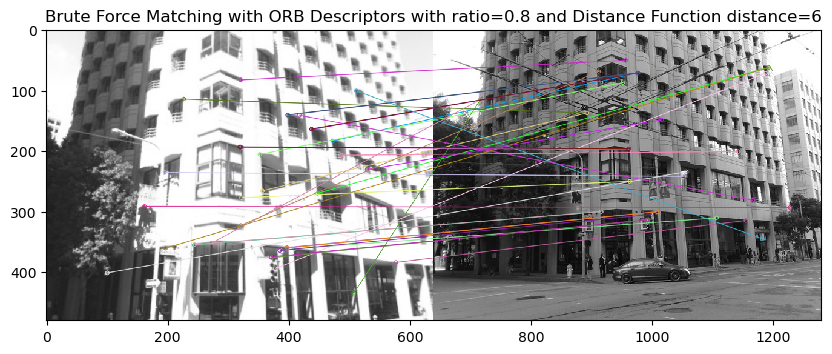

In [35]:
# ORB and feature matching with default values of ORB_create() given its good performance
L2_kp1, L2_kp2, L2_des1, L2_des2, L2_good, L2_matches = ORB_with_BFMatching(L1_img1, L1_img2, nfeatures = 1000, edgeThreshold = 41, patchSize = 41)

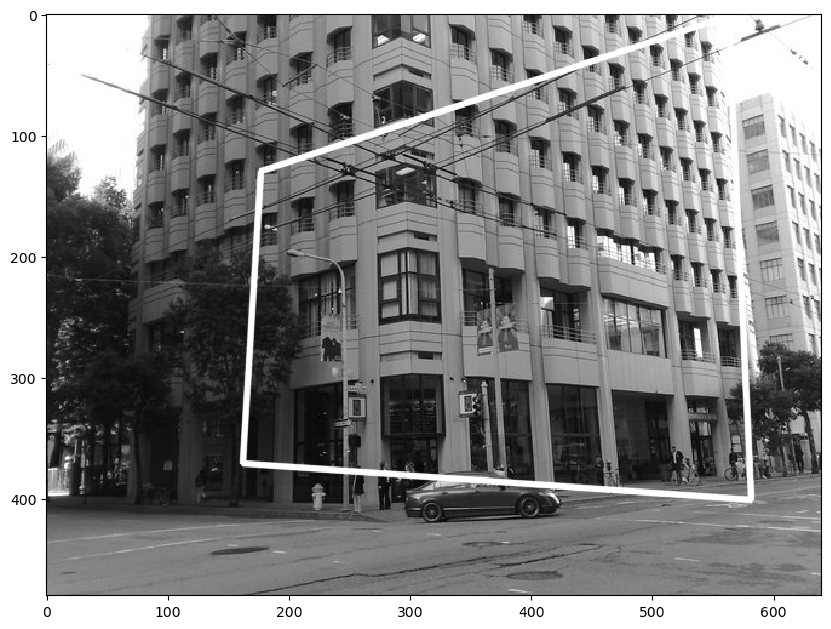

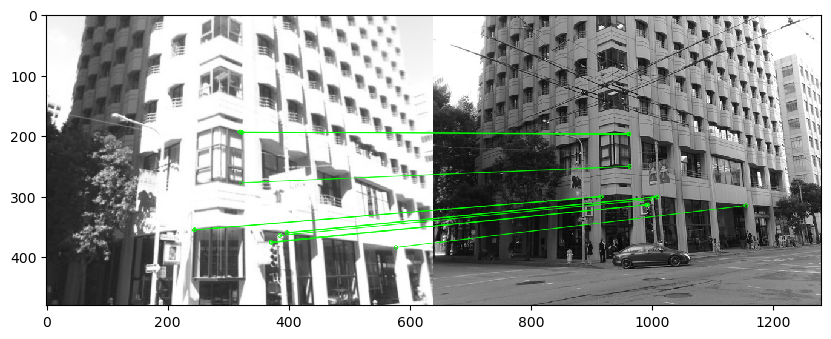

Inlier Count: 12


In [36]:
Model, mask, inlers = RANSAC_homography(L1_img1, L1_img2, L2_kp1, L2_kp2, L2_good,show=True, ransacReprojThreshold=7)

***Explanation and Comparison***

**Parameters Summary between the Two Attempts:**


| Parameter                     | Initial          | Improved         |
|-------------------------------|------------------|------------------|
| Ratio Threshold               | 0.8              | 0.8              |
| Distance Function             | Hamming Distance | Hamming Distance |
| Number of Features            | 500              | 1000             |
| Scale Factor                  | 1.2              | 1.2              |
| Patch Size and Edge Threshold | 31               | 41               |
| Score Type                    | Harris Score     | Harris Score     |
| Reprojection Threshold        | 5                | 7                |

**Results Summary between the Two Attempts:**

|                               | Initial          | Improved         |
|-------------------------------|------------------|------------------|
| Total Matches                | 500              | 1000             |
| Number of Good Matches             | 30 | 35 |
| Number of Inliers            | 9            | 11             |


Reason for image: I chose landmark 28 after flipping through the image given that this pair is reasonably close to each other. We see that the reference image is slightlhy zoomed in and is taken at a different time of day as implied by the shadows and brightness of the difference pictures. I wanted to check if ORB can perform well on different objects despite changes in absolute brightness values given the min and max values within the image.

Discussion:

- It can be observed that increasing the ReprojectionThreshold allowed for better estimation by allowing a larger "gap" between the converted points and the actual destination points or in other words, relaxing the strictness of the Reprojection. 
- We see that the good matches has higher quality good matches compared to the previous attempt. It can be seen that the keypoint correspondence were correct in this scenario.
- Lastly, we see that the outline reasonably captures the outline of the rightmost edge of the building so we can see that the ouline of the homography estimation has significantly improved. From this standpoint, we can conclude that the improvement was successful.

# Question 2: What am I looking at? (40%)


<!--One application of feature matching is image retrieval. The goal of image retrieval is, given a query image of an object, to find all images in a database containing the same object, and return the results in ranked order (like a Google search). This is a huge research area but we will implement a very basic version of the problem based on the small dataset provided.-->

In this question, the aim is to identify an "unknown" object depicted in a query image, by matching it to multiple reference images, and selecting the highest scoring match. Since we only have one reference image per object, there is at most one correct answer. This is useful for example if you want to automatically identify a book from a picture of its cover, or a painting or a geographic location from an unlabelled photograph of it.

The steps are as follows:

1. Select a set of reference images and their corresponding query images. 

    1. Hint 1: Start with the book covers, or just a subset of them.
    3. Hing 2: This question can require a lot of computation to run from start to finish, so cache intermediate results (e.g. feature descriptors) where you can.
    
2. Choose one query image corresponding to one of your reference images. Use RANSAC to match your query image to each reference image, and count the number of inlier matches found in each case. This will be the matching score for that image.

3. Identify the query object. This is the identity of the reference image with the highest match score, or "not in dataset" if the maximum score is below a threshold.

4. Repeat steps 2-3 for every query image and report the overall accuracy of your method (that is, the percentage of query images that were correctly matched in the dataset). Discussion of results should include both overall accuracy and individual failure cases.

    1. Hint 1: In case of failure, what ranking did the actual match receive? If we used a "top-k" accuracy measure, where a match is considered correct if it appears in the top k match scores, would that change the result?

<!--Code to implement this algorithm should mostly be written in a supporting file such as a2code.py. Call your code and display outputs in the notebook below.--> 


In [37]:
# Your code to identify query objects and measure search accuracy for data set here 
def getFiles(dir):
    """
    Get all files in a directory
    """
    file_paths = []
    for root, directories, files in os.walk((dir)):
        # sort to preserve numerical order
        for file in sorted(files):
            file_paths.append(os.path.join(root, file))
    return file_paths

def match_score(ref_img, q_img):
    """
    Returns the number of inliers between reference and query images
    """
    try:
        ref_kp, q_kp, ref_des, q_des, good_matches, all_matches = ORB_with_BFMatching(ref_img, q_img, show=False)
        model, mask, inliers = RANSAC_homography(ref_img, q_img, ref_kp, q_kp, good_matches, show=False)
        return inliers
    except:
        print("An error in matching occured: Usually this is when there are no descriptors")
        return 0

## Book Cover Identification

In [38]:
# Store images into lists
book_ref_imgs = getFiles(PATH + '/A2_smvs/book_covers/Reference')
book_query_imgs = getFiles(PATH + '/A2_smvs/book_covers/Query')

book_rfs = []
book_qs = []

for ref, q in zip(book_ref_imgs, book_query_imgs):
    book_rfs.append(cv2.imread(ref, 0))
    book_qs.append(cv2.imread(q, 0))

### Identify one object

#### Randomly match one object

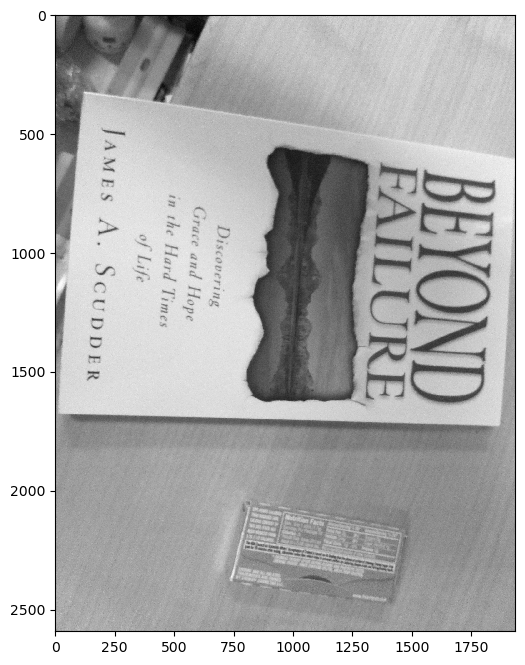

In [39]:
# Choosing a random image to test
plt.imshow(book_qs[100])

Best Score: 14 at index 100


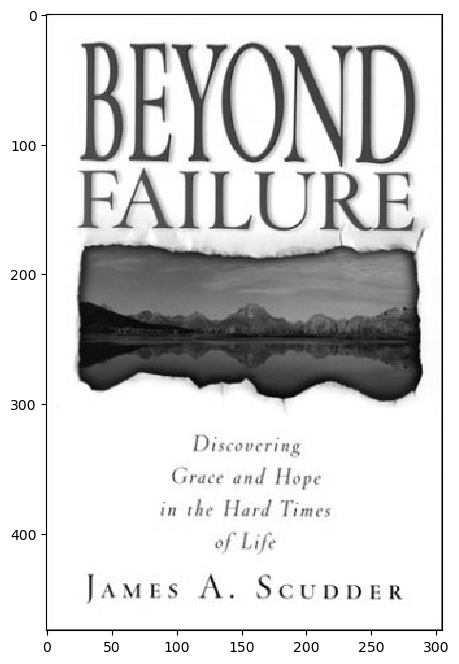

In [108]:
top_candidate = None
best_score = -float('inf')
for i, rf_img in enumerate(book_rfs):
    score = match_score(rf_img, book_qs[100])
    # if score == 0:
    #     print(f"Not enough matches at {i}")
    if score > best_score:
        best_score = score
        top_candidate = rf_img

if best_score < 10:
    print("Not in Dataset")
else:
    print(f"Best Score: {best_score} at index {i}")
    plt.imshow(rf_img)


### Identifying the model's overall accuracy with top-K values

We will set a minimum score threshold of 10. Any match value below this will not be considered.

In [41]:
top_1 = []
top_2 = []
top_5 = []

for q in book_qs:
    currScores = []
    for i, ref in enumerate(book_rfs):
        score = match_score(ref, q)
        currScores.append((score, book_ref_imgs[i]))
    currScores.sort(key=lambda x: x[0], reverse=True)
    top_1.append(currScores[0])
    top_2.append(currScores[:2])
    top_5.append(currScores[:5])

#### Randomly insepct one query image against its top 5 matches

Query Image:


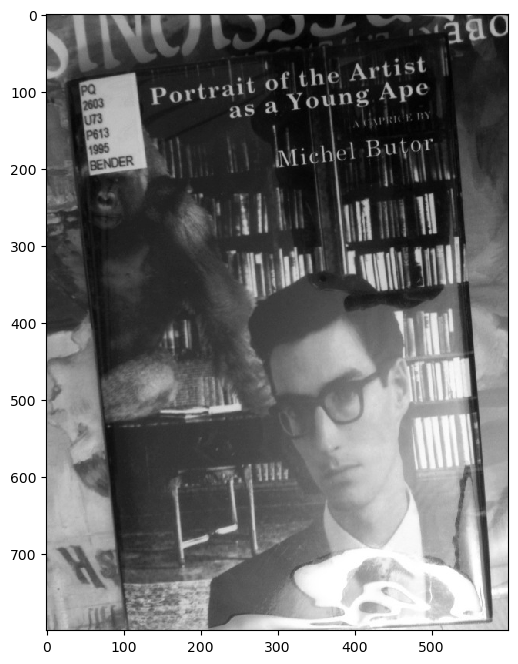

Top 5 Images:
Score: 61


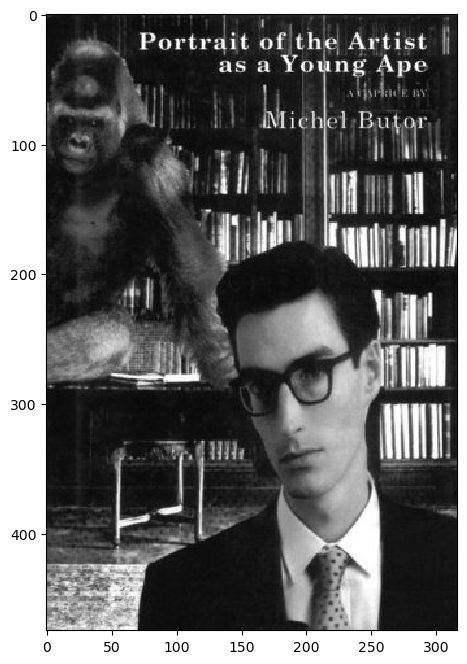

Score: 11


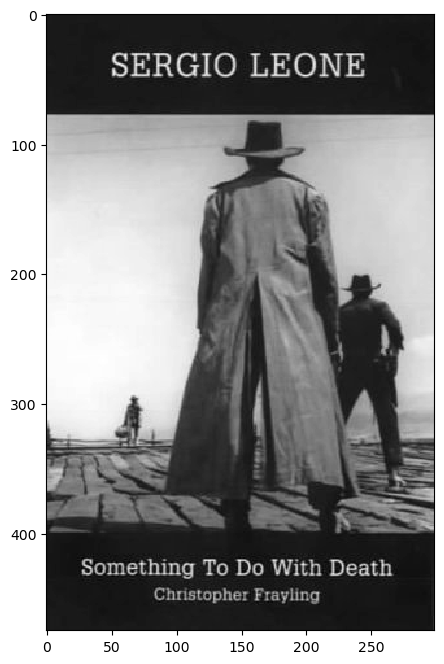

Score: 11


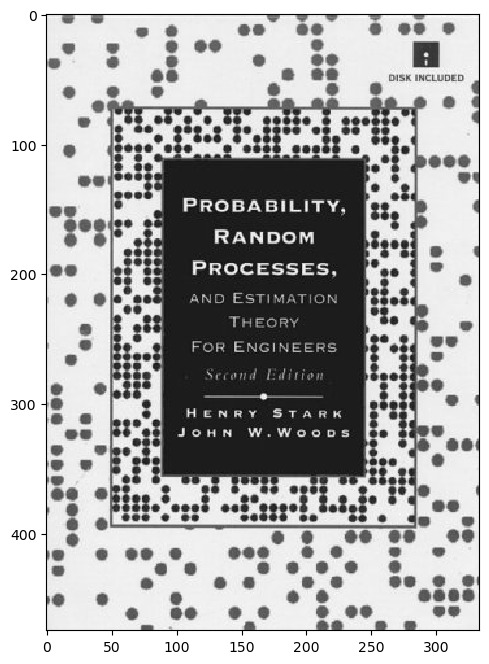

Score: 10


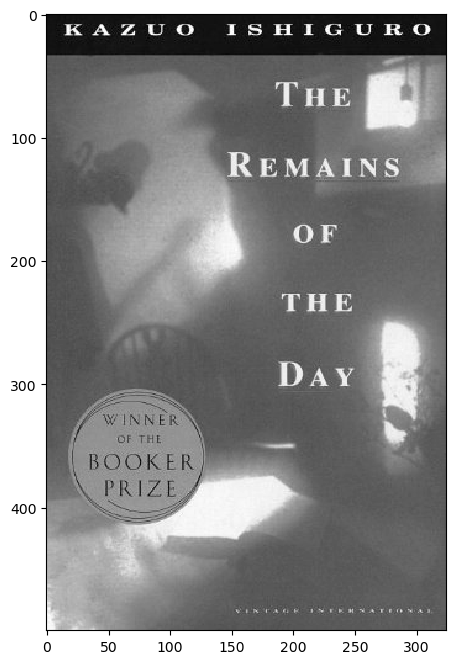

Score: 7


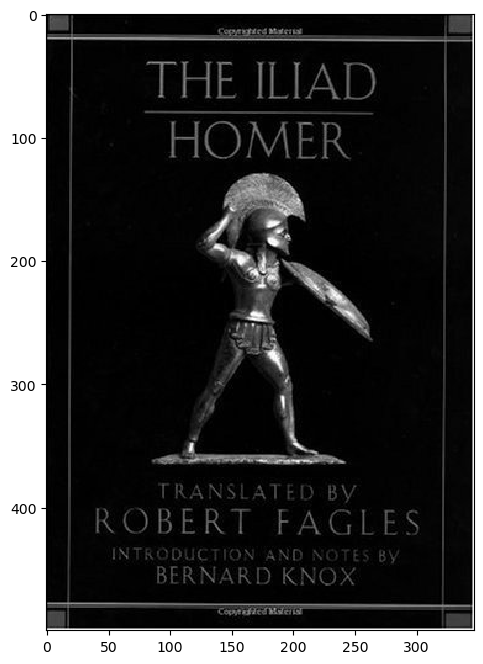

In [42]:
# randomly inpsect one query image with its top 5 images
query_index = 50
print("Query Image:")
plt.imshow(book_qs[query_index])
plt.show()

print("Top 5 Images:")
for img in top_5[query_index]:
    print(f"Score: {img[0]}")
    plt.imshow(cv2.imread(img[1], 0))
    plt.show()

#### top-1 Accuracy

In [43]:
filtered_top_1 = [x if x[0] > 10 else "Not in Dataset" for x in top_1]
filtered_top_1

correct = 0
for i, v in enumerate(filtered_top_1):
    if v == "Not in Dataset":
        continue
    if book_ref_imgs[i] in v[1]:
        correct += 1

top_1_accuracy = correct / len(filtered_top_1)
print(f"Top_1 Accuracy: {top_1_accuracy}")

Top_1 Accuracy: 0.6534653465346535


#### top-2 Accuracy

In [44]:
filtered_top_2 = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_2]
filtered_top_2

correct_top_2 = 0
for i, v in enumerate(filtered_top_2):
    # print(i,v)
    if v == "Not in Dataset":
        continue
    for img in v:
        # print('a')
        if book_ref_imgs[i] in img[1]:
            correct_top_2 += 1
            break

top_2_accuracy = correct_top_2 / len(filtered_top_2)
print(f"Top_2 Accuracy: {top_2_accuracy}")

Top_2 Accuracy: 0.6732673267326733


#### top-5 Accuracy

In [45]:
filtered_top_5 = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_5]
filtered_top_5

correct_top_5 = 0
for i, v in enumerate(filtered_top_5):
    # print(i,v)
    if v == "Not in Dataset":
        continue
    for img in v:
        # print('a')
        if book_ref_imgs[i] in img[1]:
            correct_top_5 += 1
            break

top_5_accuracy = correct_top_5 / len(filtered_top_5)
print(f"Top_5 Accuracy: {top_5_accuracy}")

Top_5 Accuracy: 0.6831683168316832


***Explanation***

Results: 


- Top-1 Accuracy: 65.34%
- Top-2 Accuracy: 67.33%
- Top-5 Accuracy: 68.32%

We see that the accuracy increases as we increase k. However, we see that the values are not too far different. This may be due to the fact that the threshold is abritrarily set to 10, but this may be the overall performance of ORB at dfeauly values.

5. Choose some extra query images of objects that do not occur in the reference dataset. Repeat step 4 with these images added to your query set. Accuracy is now measured by the percentage of query images correctly identified in the dataset, or correctly identified as not occurring in the dataset. Report how accuracy is altered by including these queries, and any changes you have made to improve performance.

### Identifying the model's overall accuracy with top-K values with error images

In [46]:
# Adding pictures from landmark and painting datasets
landmark_ref_imgs = getFiles(PATH + '/A2_smvs/landmarks/Reference')
landmark_query_imgs = getFiles(PATH + '/A2_smvs/landmarks/Query')

museum_ref_imgs = getFiles(PATH + '/A2_smvs/museum_paintings/Reference')
museum_query_imgs = getFiles(PATH + '/A2_smvs/museum_paintings/Query')

for i in range(5):
    # Add first 5 of landmarks and museum paintings in the book dataset
    book_qs.append(cv2.imread(landmark_query_imgs[i], 0))
    book_qs.append(cv2.imread(museum_query_imgs[i], 0))

In [ ]:
# Your code to run extra queries and display results here
top_1_error = []
top_2_error = []
top_5_error = []

for q in book_qs:
    currScores = []
    for i, ref in enumerate(book_rfs):
        score = match_score(ref, q)
        currScores.append((score, book_ref_imgs[i]))
    currScores.sort(key=lambda x: x[0], reverse=True)
    top_1_error.append(currScores[0])
    top_2_error.append(currScores[:2])
    top_5_error.append(currScores[:5])

#### top-1 Accuracy

In [72]:
filtered_top_1_error = [x if x[0] > 10 else "Not in Dataset" for x in top_1_error]

correct_top_1_error = 0
for i in range(len(book_ref_imgs)):
    if filtered_top_1_error[i] == "Not in Dataset":
        continue
    if book_ref_imgs[i] in filtered_top_1_error[i][1]:
        correct_top_1_error  += 1

for i in range(-10, 1):
    if filtered_top_1_error[i] == "Not in Dataset":
        correct_top_1_error  += 1
        
top_1_error_accuracy = correct_top_1_error / len(filtered_top_1_error)
print(f"Top_1 Accuracy with errors: {top_1_error_accuracy}")

Top_1 Accuracy with errors: 0.6576576576576577


#### top-2 Accuracy

In [73]:
filtered_top_2_error = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_2_error]

correct_top_2_error = 0
for i in range(len(book_ref_imgs)):
    if filtered_top_2_error[i] == "Not in Dataset":
        continue
    for img in filtered_top_2_error[i]:
        # print('a')
        if book_ref_imgs[i] in img[1]:
            correct_top_2_error += 1
            break

for i in range(-10, 1):
    if filtered_top_2_error[i] == "Not in Dataset":
        correct_top_2_error   += 1
        
top_2_error_accuracy = correct_top_2_error / len(filtered_top_2_error)
print(f"Top_2 Accuracy with errors: {top_2_error_accuracy}")

Top_2 Accuracy with errors: 0.6756756756756757


#### top-5 Accuracy

In [74]:
filtered_top_5_error = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_5_error]

correct_top_5_error = 0
for i in range(len(book_ref_imgs)):
    if filtered_top_5_error[i] == "Not in Dataset":
        continue
    for img in filtered_top_5_error[i]:
        # print('a')
        if book_ref_imgs[i] in img[1]:
            correct_top_5_error += 1
            break

for i in range(-10, 1):
    if filtered_top_5_error[i] == "Not in Dataset":
        correct_top_5_error += 1
        
top_5_error_accuracy = correct_top_5_error / len(filtered_top_5_error)
print(f"Top_5 Accuracy with errors: {top_5_error_accuracy}")

Top_5 Accuracy with errors: 0.6846846846846847


***Explanation***

**Summary of Results**

| Top-K | Accuracy with No Errors | Accuracy with Errors |
|-------|--------------------------|----------------------|
| 1     | 65.34                    | 65.77                |
| 2     | 67.33                    | 67.57                |
| 5     | 68.32                    | 68.47                |


It can be observed that there are marginal difference, but a low increase which implies that the model at a certain threshold level is able to determine if the image is not in the dataset. Similar to the previous subquestion, we see that as K increases the accuracy increases. However, it might be more conducive to detect other metrics to correctly tell if its able to discern False Positives and True Negatives such as with F1-scores of Precision. One improvement that will be explored at a later section of the paper is changing the parameters to what was investigated from the previous example. 

## Museum Painting Identification


6. Repeat step 4 and 5 for at least one other set of reference images from museum_paintings or landmarks, and compare the accuracy obtained. Analyse both your overall result and individual image matches to diagnose where problems are occurring, and what you could do to improve performance. Test at least one of your proposed improvements and report its effect on accuracy.


In [84]:
# Your code to search images and display results here
museum_rfs = []
museum_qs = []

for ref, q in zip(museum_ref_imgs, museum_query_imgs):
    museum_rfs.append(cv2.imread(ref, 0))
    museum_qs.append(cv2.imread(q, 0))

In [85]:
# We notice museum paintings last file is not relevant.
museum_rfs.pop()
museum_qs.pop()
museum_query_imgs.pop()
museum_ref_imgs.pop()

'./A2_smvs/museum_paintings/Reference/chFileName'

### Identifying the model's overall accuracy with top-K values

In [86]:
# Recycing the code from the previous exmaple
# Not exactly good practice but it works
def getTopKMatches(book_rfs, book_qs, book_ref_imgs):
    top_1 = []
    top_2 = []
    top_5 = []

    for q in book_qs:
        currScores = []
        for i, ref in enumerate(book_rfs):
            score = match_score(ref, q)
            currScores.append((score, book_ref_imgs[i]))
        currScores.sort(key=lambda x: x[0], reverse=True)
        top_1.append(currScores[0])
        top_2.append(currScores[:2])
        top_5.append(currScores[:5])
    return top_1, top_2, top_5

top_1_museum, top_2_museum, top_5_musem = getTopKMatches(museum_rfs, museum_qs, museum_ref_imgs)

#### top-1 Accuracy

In [87]:
filtered_top_1_museum = [x if x[0] > 10 else "Not in Dataset" for x in top_1_museum]


correct = 0
for i, v in enumerate(filtered_top_1_museum):
    if v == "Not in Dataset":
        continue
    if museum_ref_imgs[i] in v[1]:
        correct += 1

top_1_accuracy = correct / len(filtered_top_1_museum)
print(f"Top_1 Accuracy: {top_1_accuracy}")

Top_1 Accuracy: 0.4725274725274725


#### top-2 Accuracy

In [88]:
filtered_top_2_museum = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_2_museum]

correct_top_2 = 0
for i, v in enumerate(filtered_top_2_museum):
    # print(i,v)
    if v == "Not in Dataset":
        continue
    for img in v:
        # print('a')
        if museum_ref_imgs[i] in img[1]:
            correct_top_2 += 1
            break

top_2_accuracy = correct_top_2 / len(filtered_top_2_museum)
print(f"Top_2 Accuracy: {top_2_accuracy}")

Top_2 Accuracy: 0.4945054945054945


#### top-5 Accuracy

In [89]:
filtered_top_5_museum = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_5_musem]
filtered_top_5

correct_top_5 = 0
for i, v in enumerate(filtered_top_5_museum):
    # print(i,v)
    if v == "Not in Dataset":
        continue
    for img in v:
        # print('a')
        if museum_ref_imgs[i] in img[1]:
            correct_top_5 += 1
            break

top_5_accuracy = correct_top_5 / len(filtered_top_5_museum)
print(f"Top_5 Accuracy: {top_5_accuracy}")

Top_5 Accuracy: 0.5164835164835165


***Explanation***

Results: 

- Top-1 Accuracy: 47.25%
- Top-2 Accuracy: 49.45%
- Top-5 Accuracy: 51.65%

Compared to the books, it can be seen that the performance of the museum paintings is significantly lower. The same observation of increasing K increases the accuracy of the value.

### Identifying the model's overall accuracy with top-K values with error images

In [90]:
# Adding pictures from landmark and book datasets
for i in range(5):
    # Add first 5 of landmarks and museum paintings in the book dataset
    museum_qs.append(cv2.imread(landmark_query_imgs[i], 0))
    museum_qs.append(cv2.imread(book_query_imgs[i], 0))

In [ ]:
top_1_museum_error, top_2_museum_error, top_5_musem_error = getTopKMatches(museum_rfs, museum_qs, museum_ref_imgs)

#### top-1 Accuracy

In [92]:
filtered_top_1_error = [x if x[0] > 10 else "Not in Dataset" for x in top_1_museum_error]

correct_top_1_error = 0
for i in range(len(museum_ref_imgs)):
    if filtered_top_1_error[i] == "Not in Dataset":
        continue
    if museum_ref_imgs[i] in filtered_top_1_error[i][1]:
        correct_top_1_error  += 1

for i in range(-10, 1):
    if filtered_top_1_error[i] == "Not in Dataset":
        correct_top_1_error  += 1
        
top_1_error_accuracy = correct_top_1_error / len(filtered_top_1_error)
print(f"Top_1 Accuracy with errors: {top_1_error_accuracy}")

Top_1 Accuracy with errors: 0.504950495049505


#### top-2 Accuracy

In [94]:
filtered_top_2_error = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_2_museum_error]

correct_top_2_error = 0
for i in range(len(museum_ref_imgs)):
    if filtered_top_2_error[i] == "Not in Dataset":
        continue
    for img in filtered_top_2_error[i]:
        # print('a')
        if museum_ref_imgs[i] in img[1]:
            correct_top_2_error += 1
            break

for i in range(-10, 1):
    if filtered_top_2_error[i] == "Not in Dataset":
        correct_top_2_error   += 1
        
top_2_error_accuracy = correct_top_2_error / len(filtered_top_2_error)
print(f"Top_2 Accuracy with errors: {top_2_error_accuracy}")

Top_2 Accuracy with errors: 0.5247524752475248


#### top-5 Accuracy

In [96]:
filtered_top_5_error = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_5_musem_error]

correct_top_5_error = 0
for i in range(len(museum_ref_imgs)):
    if filtered_top_5_error[i] == "Not in Dataset":
        continue
    for img in filtered_top_5_error[i]:
        # print('a')
        if museum_ref_imgs[i] in img[1]:
            correct_top_5_error += 1
            break

for i in range(-10, 1):
    if filtered_top_5_error[i] == "Not in Dataset":
        correct_top_5_error += 1
        
top_5_error_accuracy = correct_top_5_error / len(filtered_top_5_error)
print(f"Top_5 Accuracy with errors: {top_5_error_accuracy}")

Top_5 Accuracy with errors: 0.5445544554455446


***Explanation***

**Summary of Results**

| Top-K | Accuracy with No Errors | Accuracy with Errors |
|-------|--------------------------|----------------------|
| 1     | 47.25                    | 50.45                |
| 2     | 49.45                    | 52.48                |
| 5     | 51.65                    | 54.45                |


We can see that the accuracy given errors in the dataset increase, and we can reasonably assume that the arbritrary threshold and ORB does a good job at detecting if there is no corresponding image of query in the reference. However, as elaborated in the previous question, it might be worthwhile to explore other metrics to have a more definitive values and also increase the image set sizes. 

#### Random Samples

Query Image:


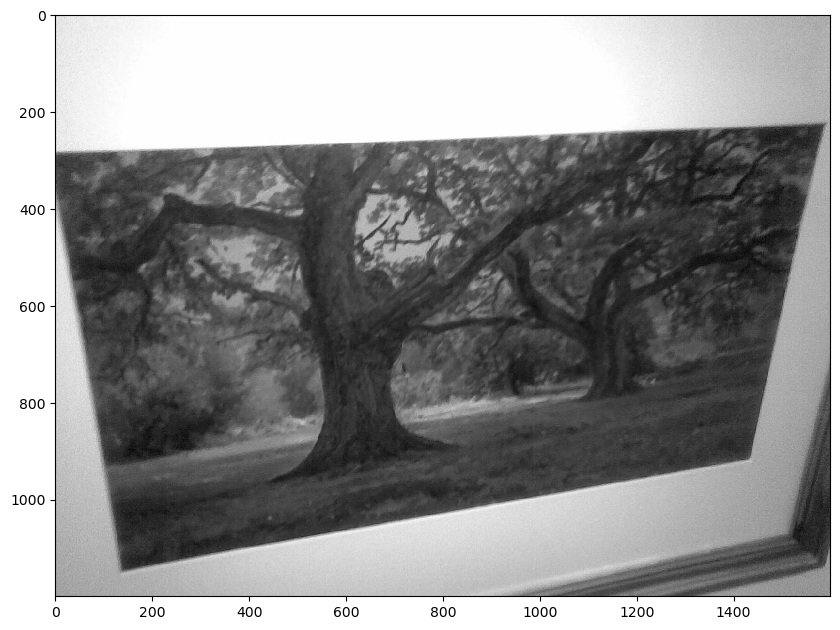

In [97]:
# Choose abritrary image to test
query_index = 74
print("Query Image:")
plt.imshow(museum_qs[query_index])

Score: 54


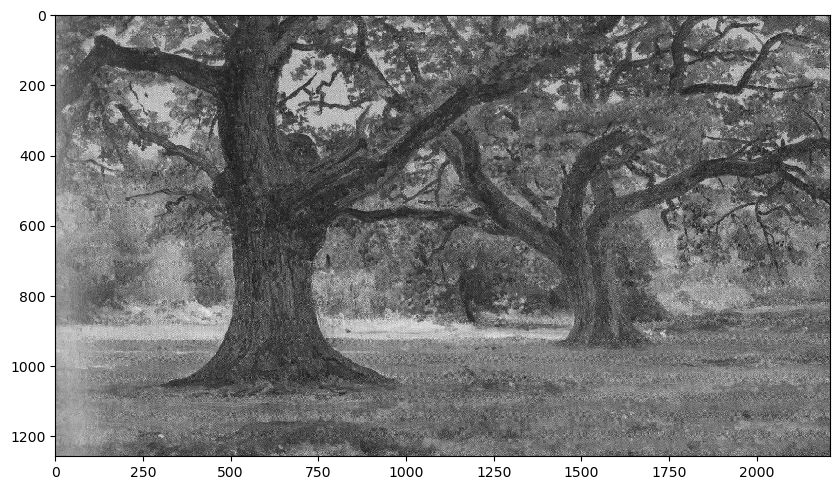

Score: 8


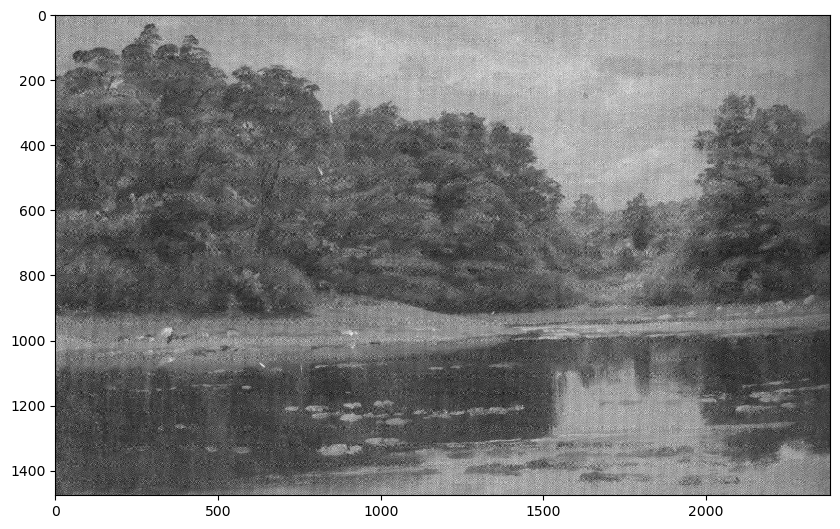

Score: 7


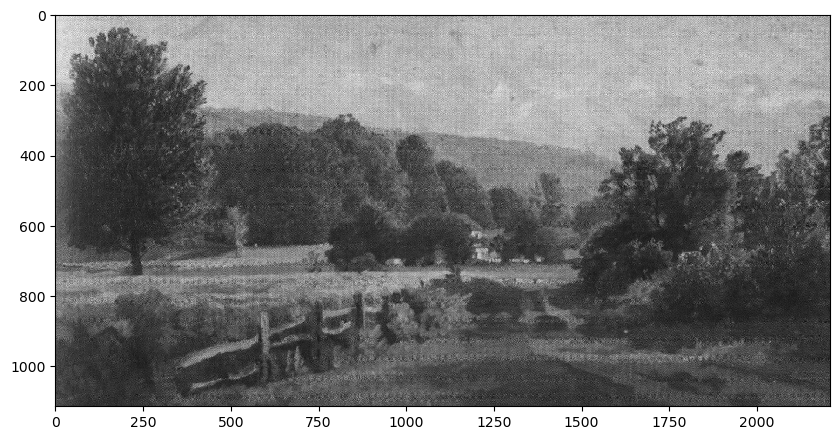

Score: 7


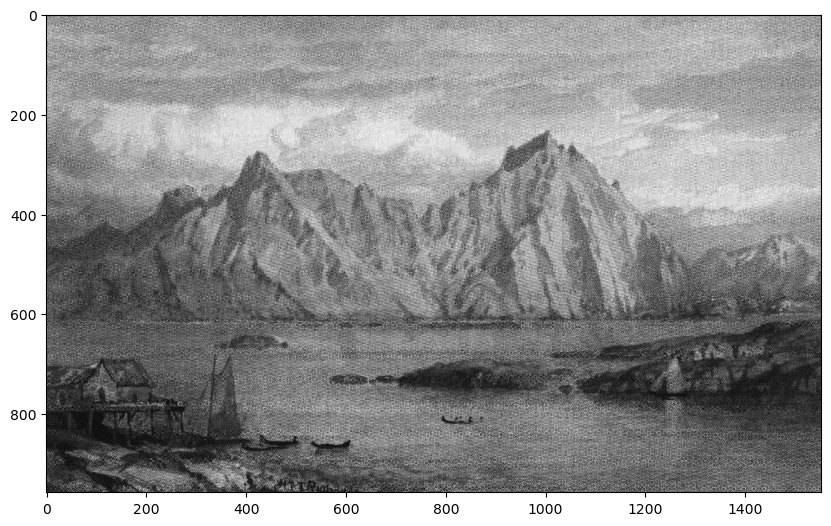

Score: 7


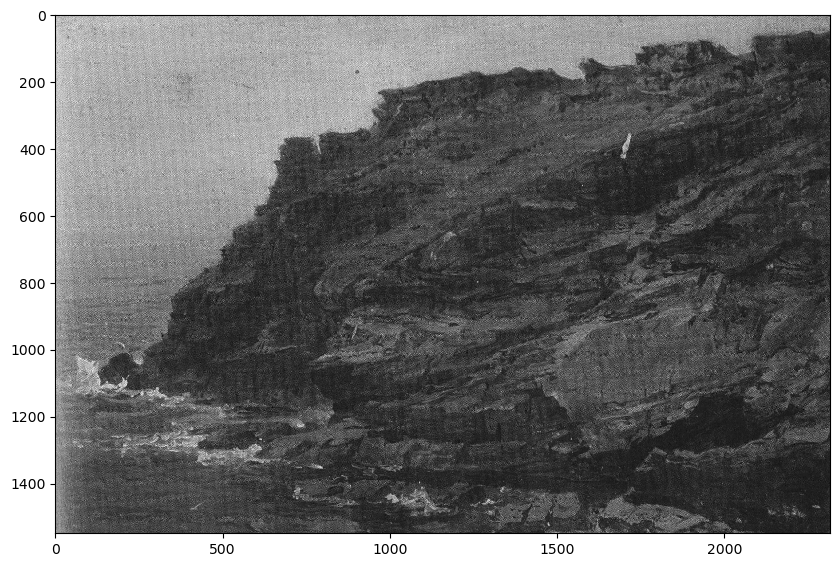

In [99]:
for img in top_5_musem_error[query_index]:
    print(f"Score: {img[0]}")
    plt.imshow(cv2.imread(img[1], 0))
    plt.show()

### Improvements

As explored in the landscape picture, we can make the criteria more lax and see how this impacts the ordering and detection of the reference image given a query image.

In [100]:
def match_score(ref_img, q_img):
    """
    Returns the number of inliers between reference and query images
    """
    try:
        ref_kp, q_kp, ref_des, q_des, good_matches, all_matches = ORB_with_BFMatching(ref_img, q_img, show=False, nfeatures=1000, edgeThreshold=41, patchSize=41)
        model, mask, inliers = RANSAC_homography(ref_img, q_img, ref_kp, q_kp, good_matches, show=False, ransacReprojThreshold=7)
        return inliers
    except:
        print("An error in matching occured: Usually this is when there are no descriptors")
        return 0

In [ ]:
top_1_museum_error, top_2_museum_error, top_5_musem_error = getTopKMatches(museum_rfs, museum_qs, museum_ref_imgs)

Checking top-5 and checking if its improved:

In [102]:
filtered_top_5_error = [x if max([y[0] for y in x]) > 10 else "Not in Dataset" for x in top_5_musem_error]

correct_top_5_error = 0
for i in range(len(museum_ref_imgs)):
    if filtered_top_5_error[i] == "Not in Dataset":
        continue
    for img in filtered_top_5_error[i]:
        # print('a')
        if museum_ref_imgs[i] in img[1]:
            correct_top_5_error += 1
            break

for i in range(-10, 1):
    if filtered_top_5_error[i] == "Not in Dataset":
        correct_top_5_error += 1
        
top_5_error_accuracy = correct_top_5_error / len(filtered_top_5_error)
print(f"Top_5 Accuracy with errors: {top_5_error_accuracy}")

Top_5 Accuracy with errors: 0.5148514851485149


***Explanation***

At the best case of top-5, we see that changing the values of the parameters actually yielded to lower performance of 51.59% from 54.45% the previous sub-question. Further exploration of ROC-AUC values on F1-scores should be explored. 

# References

Lowe, D.G. Distinctive Image Features from Scale-Invariant Keypoints. International Journal of Computer Vision 60, 91–110 (2004). https://doi.org/10.1023/B:VISI.0000029664.99615.94

In [ ]:
def addition(a,b):
    return a + b

In [ ]:
int addition(int a, int b) {
    return a + b;
}